In [0]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
from sklearn.feature_extraction.text import CountVectorizer
from wordcloud import WordCloud, STOPWORDS
import nltk
from nltk import ngrams, NaiveBayesClassifier
from string import punctuation
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import LSTM
from keras.layers.wrappers import Bidirectional
from keras.layers import Embedding
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
from gensim.models.keyedvectors import KeyedVectors
import math
from sklearn.metrics import classification_report, confusion_matrix
from google.colab import drive
from google.colab import files
warnings.filterwarnings('ignore')

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm
Using TensorFlow backend.


In [0]:
drive.mount('/content/gdrive')
path = 'gdrive/My Drive/Colab Notebooks/Effectiveness of Drug Hackerearth/'
path

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/gdrive


'gdrive/My Drive/Colab Notebooks/Effectiveness of Drug Hackerearth/'

In [0]:
import tensorflow as tf
tf.test.gpu_device_name()

'/device:GPU:0'

In [0]:
from tensorflow.python.client import device_lib
device_lib.list_local_devices()

[name: "/device:CPU:0"
 device_type: "CPU"
 memory_limit: 268435456
 locality {
 }
 incarnation: 14602081739546639440, name: "/device:XLA_CPU:0"
 device_type: "XLA_CPU"
 memory_limit: 17179869184
 locality {
 }
 incarnation: 9290437015438470717
 physical_device_desc: "device: XLA_CPU device", name: "/device:XLA_GPU:0"
 device_type: "XLA_GPU"
 memory_limit: 17179869184
 locality {
 }
 incarnation: 9315036315133229731
 physical_device_desc: "device: XLA_GPU device", name: "/device:GPU:0"
 device_type: "GPU"
 memory_limit: 14648777152
 locality {
   bus_id: 1
   links {
   }
 }
 incarnation: 12429739797726890807
 physical_device_desc: "device: 0, name: Tesla T4, pci bus id: 0000:00:04.0, compute capability: 7.5"]

## Preapring Train Data

In [0]:
# reading the training data
drug_data_train_master = pd.read_csv(path + 'updated_dataset/train.csv')
drug_data_train = drug_data_train_master.copy()

In [0]:
drug_data_train.head()

,patient_id,name_of_drug,use_case_for_drug,review_by_patient,effectiveness_rating,drug_approved_by_UIC,number_of_times_prescribed,base_score
0,206461,Valsartan,Left Ventricular Dysfunction,"""It has no side effect, I take it in combinati...",9,20-May-12,27,8.022969
1,95260,Guanfacine,ADHD,"""My son is halfway through his fourth week of ...",8,27-Apr-10,192,7.858458
2,92703,Lybrel,Birth Control,"""I used to take another oral contraceptive, wh...",5,14-Dec-09,17,6.341969
3,35696,Buprenorphine / naloxone,Opiate Dependence,"""Suboxone has completely turned my life around...",9,27-Nov-16,37,6.590176
4,155963,Cialis,Benign Prostatic Hyperplasia,"""2nd day on 5mg started to work with rock hard...",2,28-Nov-15,43,6.144782


In [0]:
def get_data_info(df):
    print('Data has', df.shape[0], 'rows and', df.shape[1], 'columns', end = '\n\n')
    data_info = pd.DataFrame(index = None, columns=['Column', 'Unique Entries', 'Null Entries', 'Data Type', 'Min', 'Max', 'Mean', 'Std Dev'])
    data_info['Column'] = df.columns
    data_info['Unique Entries'] = [df[col].nunique() for col in df.columns]
    data_info['Null Entries'] = [df[col].isnull().sum() for col in df.columns]
    data_info['Data Type'] = [df[col].dtype for col in df.columns]
    data_info['Min'] = [df[col].min() if ('int' in str(df[col].dtype) or 'float' in str(df[col].dtype))  else 'NA' for col in df.columns]
    data_info['Max'] = [df[col].max() if ('int' in str(df[col].dtype) or 'float' in str(df[col].dtype))  else 'NA' for col in df.columns]
    data_info['Mean'] = [df[col].mean() if ('int' in str(df[col].dtype) or 'float' in str(df[col].dtype))  else 'NA' for col in df.columns]
    data_info['Std Dev'] = [df[col].std() if ('int' in str(df[col].dtype) or 'float' in str(df[col].dtype))  else 'NA' for col in df.columns]
    return data_info

In [0]:
data_info = get_data_info(drug_data_train)
data_info

Data has 32165 rows and 8 columns



,Column,Unique Entries,Null Entries,Data Type,Min,Max,Mean,Std Dev
0,patient_id,32165,0,int64,9,232289,115488,67146.2
1,name_of_drug,2220,0,object,NA,NA,NA,NA
2,use_case_for_drug,636,0,object,NA,NA,NA,NA
3,review_by_patient,30121,0,object,NA,NA,NA,NA
4,effectiveness_rating,10,0,int64,1,10,6.99891,3.27478
5,drug_approved_by_UIC,3537,0,object,NA,NA,NA,NA
6,number_of_times_prescribed,303,0,int64,0,771,27.8932,35.819
7,base_score,1383,0,float64,0.899076,8.99245,6.66426,1.5887


In [0]:
def extract_days(date):
    date = str(date)
    return int(date.split(' ')[0]) # days in use can never be 0, consider the start as 1

In [0]:
# find number of days a drug is in use
drug_data_train['drug_approved_by_UIC'] = pd.to_datetime(drug_data_train['drug_approved_by_UIC'])
drug_data_train['days_in_use'] = (drug_data_train['drug_approved_by_UIC']-drug_data_train['drug_approved_by_UIC'].min())
drug_data_train['days_in_use'] = drug_data_train['days_in_use'].apply(extract_days)
drug_data_train.head()

,patient_id,name_of_drug,use_case_for_drug,review_by_patient,effectiveness_rating,drug_approved_by_UIC,number_of_times_prescribed,base_score,days_in_use
0,206461,Valsartan,Left Ventricular Dysfunction,"""It has no side effect, I take it in combinati...",9,2012-05-20,27,8.022969,1547
1,95260,Guanfacine,ADHD,"""My son is halfway through his fourth week of ...",8,2010-04-27,192,7.858458,793
2,92703,Lybrel,Birth Control,"""I used to take another oral contraceptive, wh...",5,2009-12-14,17,6.341969,659
3,35696,Buprenorphine / naloxone,Opiate Dependence,"""Suboxone has completely turned my life around...",9,2016-11-27,37,6.590176,3199
4,155963,Cialis,Benign Prostatic Hyperplasia,"""2nd day on 5mg started to work with rock hard...",2,2015-11-28,43,6.144782,2834


In [0]:
# find the effective use ratio
# drug_data_train['number_of_times_prescribed'].replace(0, -1, inplace = True)
# drug_data_train['use_ratio'] = drug_data_train['number_of_times_prescribed'] / drug_data_train['days_in_use']
# drug_data_train['rev_use_ratio'] = drug_data_train['days_in_use'] / drug_data_train['number_of_times_prescribed']
# drug_data_train.head()

In [0]:
drug_data_temp = drug_data_train.drop(['patient_id', 'base_score', 'drug_approved_by_UIC'], axis = 1)

drug_data_temp['base_score'] = drug_data_train['base_score']

In [0]:
drug_data_temp.head()

,name_of_drug,use_case_for_drug,review_by_patient,effectiveness_rating,number_of_times_prescribed,days_in_use,base_score
0,Valsartan,Left Ventricular Dysfunction,"""It has no side effect, I take it in combinati...",9,27,1547,8.022969
1,Guanfacine,ADHD,"""My son is halfway through his fourth week of ...",8,192,793,7.858458
2,Lybrel,Birth Control,"""I used to take another oral contraceptive, wh...",5,17,659,6.341969
3,Buprenorphine / naloxone,Opiate Dependence,"""Suboxone has completely turned my life around...",9,37,3199,6.590176
4,Cialis,Benign Prostatic Hyperplasia,"""2nd day on 5mg started to work with rock hard...",2,43,2834,6.144782


In [0]:
get_data_info(drug_data_temp)

Data has 32165 rows and 7 columns



,Column,Unique Entries,Null Entries,Data Type,Min,Max,Mean,Std Dev
0,name_of_drug,2220,0,object,NA,NA,NA,NA
1,use_case_for_drug,636,0,object,NA,NA,NA,NA
2,review_by_patient,30121,0,object,NA,NA,NA,NA
3,effectiveness_rating,10,0,int64,1,10,6.99891,3.27478
4,number_of_times_prescribed,303,0,int64,0,771,27.8932,35.819
5,days_in_use,3537,0,int64,0,3579,2312.03,982.367
6,base_score,1383,0,float64,0.899076,8.99245,6.66426,1.5887


In [0]:
# analyzing a single use case for drug
temp_data = drug_data_temp[drug_data_temp['use_case_for_drug'] == 'ADHD']
temp_data.head()

,name_of_drug,use_case_for_drug,review_by_patient,effectiveness_rating,number_of_times_prescribed,days_in_use,base_score
1,Guanfacine,ADHD,"""My son is halfway through his fourth week of ...",8,192,793,7.858458
115,Methylphenidate,ADHD,"""I had a great experience with this medication...",10,72,52,8.720363
129,Daytrana,ADHD,"""I am a 22 yr old female. Hated the significan...",9,24,717,7.084225
168,Strattera,ADHD,"""I&#039;m a 47 yr old female. This medicine gr...",5,15,1103,7.069598
245,Atomoxetine,ADHD,"""great drug with few if any side effects.... e...",10,16,2990,8.709533


In [0]:
# print('Covariance Matrix for use_ratio:\n', np.cov(drug_data_temp['use_ratio'], drug_data_temp['base_score']))
# print('\nCorrelation if use_ratio with base_score:', drug_data_temp['use_ratio'].corr(drug_data_temp['base_score']))

In [0]:
print('Covariance Matrix for effectiveness vs base score:\n', np.cov(drug_data_temp['effectiveness_rating'], drug_data_temp['base_score']))
print('\nCorrelation of effectiveness with base_score:', drug_data_temp['effectiveness_rating'].corr(drug_data_temp['base_score']))

Covariance Matrix for effectiveness vs base score:
 [[10.72419357  2.14505648]
 [ 2.14505648  2.52396556]]

Correlation of effectiveness with base_score: 0.4123012926371876


In [0]:
print('Covariance Matrix for number_of_times_prescribed vs base score:\n', np.cov(drug_data_temp['number_of_times_prescribed'], drug_data_temp['base_score']))
print('\nCorrelation of number_of_times_prescribed with base_score:', drug_data_temp['number_of_times_prescribed'].corr(drug_data_temp['base_score']))

Covariance Matrix for number_of_times_prescribed vs base score:
 [[1283.00323858    7.64212986]
 [   7.64212986    2.52396556]]

Correlation of number_of_times_prescribed with base_score: 0.13429468495875782


In [0]:
print('Covariance Matrix for days_in_use vs base_score:\n', np.cov(drug_data_temp['days_in_use'], drug_data_temp['base_score']))
print('\nCorrelation of days_in_use with base_score:', drug_data_temp['days_in_use'].corr(drug_data_temp['base_score']))

Covariance Matrix for days_in_use vs base_score:
 [[ 9.65044657e+05 -1.38232487e+02]
 [-1.38232487e+02  2.52396556e+00]]

Correlation of days_in_use with base_score: -0.08857164336679553


In [0]:
# print('Covariance Matrix for rev_use_ratio:\n', np.cov(drug_data_temp['rev_use_ratio'], drug_data_temp['base_score']))
# print('\nCorrelation of effectiveness with base_score:', drug_data_temp['rev_use_ratio'].corr(drug_data_temp['base_score']))

In [0]:
print('Covariance Matrix for days_in_use vs eff rating:\n', np.cov(drug_data_temp['days_in_use'], drug_data_temp['effectiveness_rating']))
print('\nCorrelation of days_in_use with eff rating:', drug_data_temp['days_in_use'].corr(drug_data_temp['effectiveness_rating']))

Covariance Matrix for days_in_use vs eff rating:
 [[ 9.65044657e+05 -6.46902096e+02]
 [-6.46902096e+02  1.07241936e+01]]

Correlation of days_in_use with eff rating: -0.2010863221280059


In [0]:
print('Covariance Matrix for prescribed vs eff rating:\n', np.cov(drug_data_temp['number_of_times_prescribed'], drug_data_temp['effectiveness_rating']))
print('\nCorrelation of prescribed with eff rating:', drug_data_temp['number_of_times_prescribed'].corr(drug_data_temp['effectiveness_rating']))

Covariance Matrix for prescribed vs eff rating:
 [[1283.00323858   28.41270558]
 [  28.41270558   10.72419357]]

Correlation of prescribed with eff rating: 0.24222356551594856


In [0]:
# print('Covariance Matrix for rev_use_ratio:\n', np.cov(drug_data_temp['use_ratio'], drug_data_temp['effectiveness_rating']))
# print('\nCorrelation of effectiveness with base_score:', drug_data_temp['use_ratio'].corr(drug_data_temp['effectiveness_rating']))

In [0]:
# print('Covariance Matrix for rev_use_ratio:\n', np.cov(drug_data_temp['rev_use_ratio'], drug_data_temp['effectiveness_rating']))
# print('\nCorrelation of effectiveness with base_score:', drug_data_temp['rev_use_ratio'].corr(drug_data_temp['effectiveness_rating']))

In [0]:
drug_data_temp = drug_data_temp.drop(['days_in_use'], axis = 1)
drug_data_temp.head()

,name_of_drug,use_case_for_drug,review_by_patient,effectiveness_rating,number_of_times_prescribed,base_score
0,Valsartan,Left Ventricular Dysfunction,"""It has no side effect, I take it in combinati...",9,27,8.022969
1,Guanfacine,ADHD,"""My son is halfway through his fourth week of ...",8,192,7.858458
2,Lybrel,Birth Control,"""I used to take another oral contraceptive, wh...",5,17,6.341969
3,Buprenorphine / naloxone,Opiate Dependence,"""Suboxone has completely turned my life around...",9,37,6.590176
4,Cialis,Benign Prostatic Hyperplasia,"""2nd day on 5mg started to work with rock hard...",2,43,6.144782


In [0]:
get_data_info(drug_data_temp)

Data has 32165 rows and 6 columns



,Column,Unique Entries,Null Entries,Data Type,Min,Max,Mean,Std Dev
0,name_of_drug,2220,0,object,NA,NA,NA,NA
1,use_case_for_drug,636,0,object,NA,NA,NA,NA
2,review_by_patient,30121,0,object,NA,NA,NA,NA
3,effectiveness_rating,10,0,int64,1,10,6.99891,3.27478
4,number_of_times_prescribed,303,0,int64,0,771,27.8932,35.819
5,base_score,1383,0,float64,0.899076,8.99245,6.66426,1.5887


## Preparing test data

In [0]:
test_data_master = pd.read_csv(path + 'updated_dataset/test.csv')
test_data_temp = test_data_master.copy()
test_data_temp.shape

(10760, 7)

In [0]:
test_data_temp.head()

,patient_id,name_of_drug,review_by_patient,drug_approved_by_UIC,number_of_times_prescribed,use_case_for_drug,effectiveness_rating
0,163740,Mirtazapine,"""I&#039;ve tried a few antidepressants over th...",28-Feb-12,22,Depression,10
1,39293,Contrave,"""Contrave combines drugs that were used for al...",5-Mar-17,35,Weight Loss,9
2,208087,Zyclara,"""4 days in on first 2 weeks. Using on arms an...",3-Jul-14,13,Keratosis,4
3,23295,Methadone,"""Ive been on Methadone for over ten years and ...",18-Oct-16,21,Opiate Withdrawal,7
4,97013,Ambien,"""Ditto on rebound sleepless when discontinued....",13-Jan-15,44,Insomnia,2


In [0]:
get_data_info(test_data_temp)

Data has 10760 rows and 7 columns



,Column,Unique Entries,Null Entries,Data Type,Min,Max,Mean,Std Dev
0,patient_id,10760,0,int64,21,232253,116515,66889.2
1,name_of_drug,1478,0,object,NA,NA,NA,NA
2,review_by_patient,10530,0,object,NA,NA,NA,NA
3,drug_approved_by_UIC,3070,0,object,NA,NA,NA,NA
4,number_of_times_prescribed,233,0,int64,0,484,27.596,34.0501
5,use_case_for_drug,461,0,object,NA,NA,NA,NA
6,effectiveness_rating,10,0,int64,1,10,6.96375,3.27564


In [0]:
test_data_temp.drop(['patient_id', 'drug_approved_by_UIC'], axis = 1, inplace = True)
test_data_temp.head()

,name_of_drug,review_by_patient,number_of_times_prescribed,use_case_for_drug,effectiveness_rating
0,Mirtazapine,"""I&#039;ve tried a few antidepressants over th...",22,Depression,10
1,Contrave,"""Contrave combines drugs that were used for al...",35,Weight Loss,9
2,Zyclara,"""4 days in on first 2 weeks. Using on arms an...",13,Keratosis,4
3,Methadone,"""Ive been on Methadone for over ten years and ...",21,Opiate Withdrawal,7
4,Ambien,"""Ditto on rebound sleepless when discontinued....",44,Insomnia,2


In [0]:
# test_reviews = test_data_temp['review_by_patient']
# cleaned_reviews_test = [clean(i) for i in test_reviews]
# test_review_text_cleaned = ' '.join(cleaned_reviews_test)
# test_review_text_cleaned

## Clean Reviews

In [0]:
# these words can change the meaning completely
not_stopwords = ["hasn't", "shouldn't", "doesn't", 'not', "can't", "isn't", "mustn't", "couldn't", "won't", 'cannot', 
                 "wasn't", "wouldn't", 'against', "didn't", "don't", "haven't", 'no']
bad_words = ['i', 'it','', ' ', 'ive', 've', 'im', 'hve', 'wnt', 'nt', 'vnt', '--'] + [ch for ch in punctuation]

In [0]:
def clean(text):
    clean_text = []
    stopwords = list(STOPWORDS)
    text = text.replace('&#039;', '')
    words = text.split(" ")
    for word in words:
        word = word.lower()
        # remove any mentions and hahtag sybmols
        word = word.strip()
#         print(word)
        flag = True
        if word not in bad_words and word[0] != '@' and word[0:2] != '\r' and (word not in stopwords or word in not_stopwords):
            while flag and word[0] in punctuation:
                word = word[1:]
                if word == '' or word == ' ' or word in bad_words:
                    word = ''
                    flag = False
                    break
            while flag and word[-1] in punctuation:
                word = word[:-1]
                if word == '' or word == ' ' or word in bad_words:
                    word = ''
                    flag = False
                    break
            clean_text.append(word)
    return ' '.join(clean_text)

## Feature engineering


In [0]:
drug_data_train.head()

,patient_id,name_of_drug,use_case_for_drug,review_by_patient,effectiveness_rating,drug_approved_by_UIC,number_of_times_prescribed,base_score
0,206461,Valsartan,Left Ventricular Dysfunction,"""It has no side effect, I take it in combinati...",9,20-May-12,27,8.022969
1,95260,Guanfacine,ADHD,"""My son is halfway through his fourth week of ...",8,27-Apr-10,192,7.858458
2,92703,Lybrel,Birth Control,"""I used to take another oral contraceptive, wh...",5,14-Dec-09,17,6.341969
3,35696,Buprenorphine / naloxone,Opiate Dependence,"""Suboxone has completely turned my life around...",9,27-Nov-16,37,6.590176
4,155963,Cialis,Benign Prostatic Hyperplasia,"""2nd day on 5mg started to work with rock hard...",2,28-Nov-15,43,6.144782


In [0]:
train_temp = drug_data_train.copy()
train_temp['day'] = train_temp['drug_approved_by_UIC'].apply(lambda x : x.split('-')[0].strip())
train_temp['month'] = train_temp['drug_approved_by_UIC'].apply(lambda x : x.split('-')[1].strip())
train_temp['year'] = train_temp['drug_approved_by_UIC'].apply(lambda x : x.split('-')[2].strip())
train_temp['month_class'] = train_temp['month'].apply(lambda x : 0 if x in ('Dec', 'Jan', 'Feb') else (1 if x in ('Mar', 'April', 'May') else (2 if x in ('Jun', 'Jul', 'Aug') else 3)))
train_temp.drop(['patient_id', 'drug_approved_by_UIC', 'month'], axis = 1, inplace = True)
train_temp.head()

,name_of_drug,use_case_for_drug,review_by_patient,effectiveness_rating,number_of_times_prescribed,base_score,day,year,month_class
0,Valsartan,Left Ventricular Dysfunction,"""It has no side effect, I take it in combinati...",9,27,8.022969,20,12,1
1,Guanfacine,ADHD,"""My son is halfway through his fourth week of ...",8,192,7.858458,27,10,3
2,Lybrel,Birth Control,"""I used to take another oral contraceptive, wh...",5,17,6.341969,14,09,0
3,Buprenorphine / naloxone,Opiate Dependence,"""Suboxone has completely turned my life around...",9,37,6.590176,27,16,3
4,Cialis,Benign Prostatic Hyperplasia,"""2nd day on 5mg started to work with rock hard...",2,43,6.144782,28,15,3


In [0]:
for i in train_temp['use_case_for_drug'].unique():
    if '</span> users found this comment helpful.' in i:
        train_temp['use_case_for_drug'].replace(i, '<UKN>', inplace = True)

In [0]:
# sentiment prediction
# introduce sentiment based on effectiveness
train_temp['sentiment'] = train_temp['effectiveness_rating'].apply(lambda x: 1 if x > 5 else 0)
train_temp.head()

,name_of_drug,use_case_for_drug,review_by_patient,effectiveness_rating,number_of_times_prescribed,base_score,day,year,month_class,sentiment
0,Valsartan,Left Ventricular Dysfunction,"""It has no side effect, I take it in combinati...",9,27,8.022969,20,12,1,1
1,Guanfacine,ADHD,"""My son is halfway through his fourth week of ...",8,192,7.858458,27,10,3,1
2,Lybrel,Birth Control,"""I used to take another oral contraceptive, wh...",5,17,6.341969,14,09,0,0
3,Buprenorphine / naloxone,Opiate Dependence,"""Suboxone has completely turned my life around...",9,37,6.590176,27,16,3,1
4,Cialis,Benign Prostatic Hyperplasia,"""2nd day on 5mg started to work with rock hard...",2,43,6.144782,28,15,3,0


In [0]:
train_review_cleaned = [clean(i) for i in train_temp['review_by_patient']]
train_review_cleaned[:5]

[' no side effect take combination bystolic 5 mg fish oil',
 'my son halfway fourth week intuniv became concerned began last week started taking highest dose will on two days hardly bed cranky slept nearly 8 hours drive home school vacation very unusual him called doctor monday morning said stick days see school getting morning last two days problem free much agreeable ever less emotional a good thing less cranky remembering things should overall behavior better tried many different medications far effective',
 ' used take another oral contraceptive 21 pill cycle happy light periods max 5 days no side effects contained hormone gestodene not available us switched lybrel ingredients similar pills ended started lybrel immediately first day period instructions said period lasted two weeks taking second pack two weeks now third pack things got even worse third period lasted two weeks now end third week still daily brown discharge.\r\nthe positive side didnt side effects idea period free tem

In [0]:
train_text = train_temp['name_of_drug'] + ' ' + train_temp['use_case_for_drug'] + ' ' + np.array(train_review_cleaned)
train_text[:5]

0    Valsartan Left Ventricular Dysfunction  no sid...
1    Guanfacine ADHD my son halfway fourth week int...
2    Lybrel Birth Control  used take another oral c...
3    Buprenorphine / naloxone Opiate Dependence sub...
4    Cialis Benign Prostatic Hyperplasia 2nd day 5m...
dtype: object

In [0]:
train_sentiment = train_temp['sentiment']
train_sentiment[:5] 

0    1
1    1
2    0
3    1
4    0
Name: sentiment, dtype: int64

In [0]:
test_temp = test_data_temp.copy()
test_temp['day'] = test_temp['drug_approved_by_UIC'].apply(lambda x : x.split('-')[0].strip())
test_temp['month'] = test_temp['drug_approved_by_UIC'].apply(lambda x : x.split('-')[1].strip())
test_temp['year'] = test_temp['drug_approved_by_UIC'].apply(lambda x : x.split('-')[2].strip())
test_temp['month_class'] = test_temp['month'].apply(lambda x : 0 if x in ('Dec', 'Jan', 'Feb') else (1 if x in ('Mar', 'April', 'May') else (2 if x in ('Jun', 'Jul', 'Aug') else 3)))
test_temp.drop(['patient_id', 'drug_approved_by_UIC', 'month'], axis = 1, inplace = True)
test_temp.head()

,name_of_drug,review_by_patient,number_of_times_prescribed,use_case_for_drug,effectiveness_rating,day,year,month_class
0,Mirtazapine,"""I&#039;ve tried a few antidepressants over th...",22,Depression,10,28,12,0
1,Contrave,"""Contrave combines drugs that were used for al...",35,Weight Loss,9,5,17,1
2,Zyclara,"""4 days in on first 2 weeks. Using on arms an...",13,Keratosis,4,3,14,2
3,Methadone,"""Ive been on Methadone for over ten years and ...",21,Opiate Withdrawal,7,18,16,3
4,Ambien,"""Ditto on rebound sleepless when discontinued....",44,Insomnia,2,13,15,0


In [0]:
for i in test_temp['use_case_for_drug'].unique():
    if '</span> users found this comment helpful.' in i:
        test_temp['use_case_for_drug'].replace(i, '<UKN>', inplace = True)

In [0]:
test_review_cleaned = [clean(i) for i in test_temp['review_by_patient']]
test_review_cleaned[:5]

[' tried antidepressants years citalopram fluoxetine amitriptyline none helped depression insomnia amp anxiety doctor suggested changed onto 45mg mirtazapine medicine saved life thankfully no side effects especially common weight gain actually lost alot weight still suicidal thoughts mirtazapine saved me',
 'contrave combines drugs used alcohol smoking opioid cessation people lose weight helps control over-eating no doubt obesity caused sugar/carb addiction powerful drug taking five days good news is seems go work immediately feel hungry want food now really dont care eat fill stomach days dont know lost weight  dont scale clothes feel little looser maybe pound two hoping months medication will develop healthier habits continue without aid contrave',
 '4 days first 2 weeks using arms face put vaseline lips eyes nostrils protect cream far no reaction all know many pre cancer thought light christmas tree far good maybe coming time will tell',
 ' methadone ten years currently,i trying dru

In [0]:
test_text = test_temp['name_of_drug'] + ' ' + test_temp['use_case_for_drug'] + ' ' + np.array(test_review_cleaned)
test_text[:5]

0    Mirtazapine Depression  tried antidepressants ...
1    Contrave Weight Loss contrave combines drugs u...
2    Zyclara Keratosis 4 days first 2 weeks using a...
3    Methadone Opiate Withdrawal  methadone ten yea...
4    Ambien Insomnia ditto rebound sleepless discon...
dtype: object

In [0]:
test_temp['sentiment'] = test_temp['effectiveness_rating'].apply(lambda x: 1 if x > 5 else 0)
test_temp.head()

,name_of_drug,review_by_patient,number_of_times_prescribed,use_case_for_drug,effectiveness_rating,day,year,month_class,sentiment
0,Mirtazapine,"""I&#039;ve tried a few antidepressants over th...",22,Depression,10,28,12,0,1
1,Contrave,"""Contrave combines drugs that were used for al...",35,Weight Loss,9,5,17,1,1
2,Zyclara,"""4 days in on first 2 weeks. Using on arms an...",13,Keratosis,4,3,14,2,0
3,Methadone,"""Ive been on Methadone for over ten years and ...",21,Opiate Withdrawal,7,18,16,3,1
4,Ambien,"""Ditto on rebound sleepless when discontinued....",44,Insomnia,2,13,15,0,0


In [0]:
test_sentiment = test_temp['sentiment']
test_sentiment[:5]

0    1
1    1
2    0
3    1
4    0
Name: sentiment, dtype: int64

## Data Visualization 

In [0]:
def bar_plot(x, y):
    fig = plt.figure(figsize=(20, 6))
    ax = sns.barplot(x, y)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45, horizontalalignment = 'right')
    return ax

def line_plot(x, y):
    fig = plt.figure(figsize=(8, 6))
    ax = sns.lineplot(x, y)
    return ax

def scatter_plot(x, y):
    fig = plt.figure(figsize=(8, 6))
    ax = sns.scatterplot(x, y)
    return ax

def heat_map(df):
    fig = plt.figure(figsize=(10, 10))
    ax = sns.heatmap(df, square=True, linewidth=1)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45, horizontalalignment = 'right')
    ax.set_yticklabels(ax.get_xticklabels(), rotation=45, horizontalalignment = 'right')
    return ax

def print_wordcloud(text):
    wordcloud = WordCloud(width = 800, height = 800, background_color='white', stopwords=set(STOPWORDS)).generate(text)
    fig = plt.figure(figsize=(10, 10))
    plt.imshow(wordcloud)

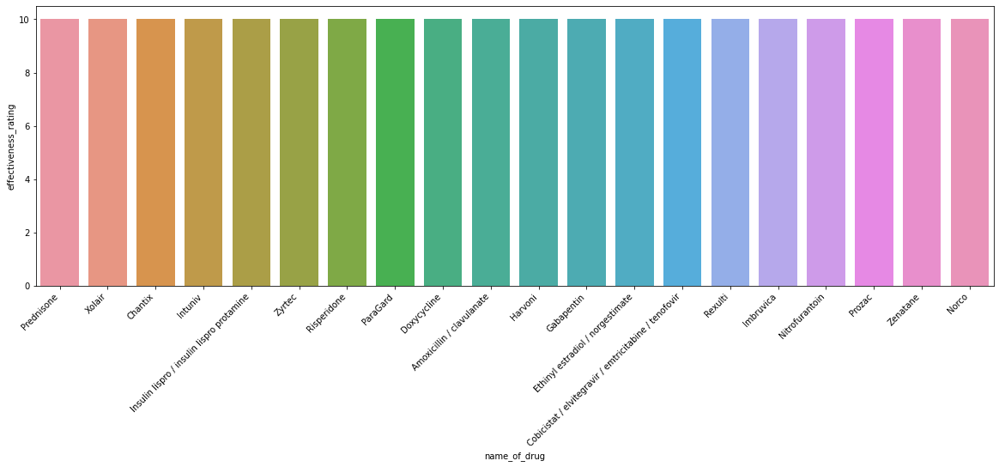

In [0]:
# top 20 drugs based on effectiveness rating
name_rating_data = drug_data_temp[['name_of_drug', 'effectiveness_rating']].sort_values('effectiveness_rating', ascending = False)
ax = bar_plot(name_rating_data['name_of_drug'][:20], name_rating_data['effectiveness_rating'][:20])

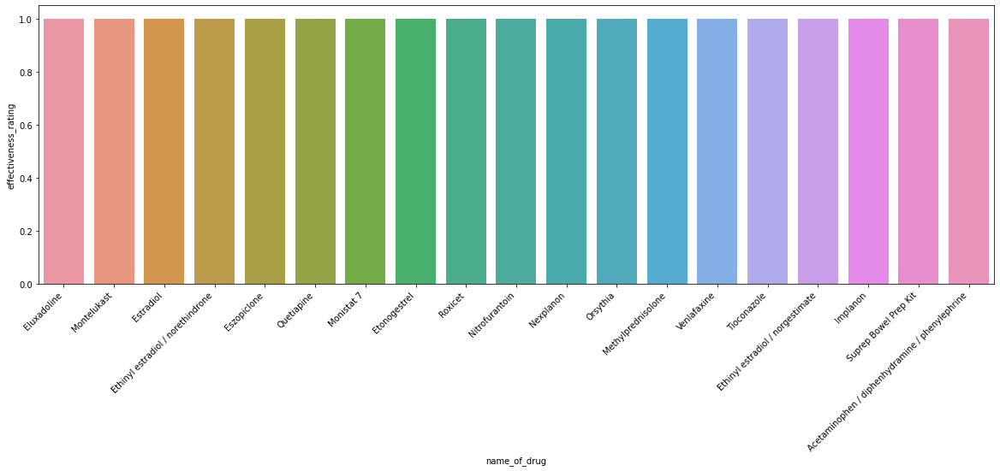

In [0]:
# bottom 20 drugs based on effectiveness
ax = bar_plot(name_rating_data['name_of_drug'][-20:], name_rating_data['effectiveness_rating'][-20:])

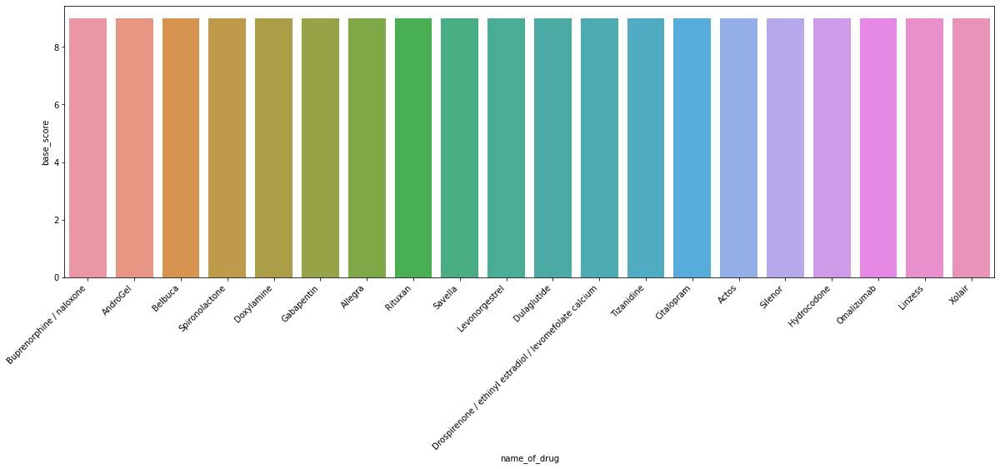

In [0]:
# top 20 drugs based on base_score
name_basescore_data = drug_data_temp[['name_of_drug', 'base_score']].sort_values('base_score', ascending = False)
ax = bar_plot(name_basescore_data['name_of_drug'][:20], name_basescore_data['base_score'][:20])

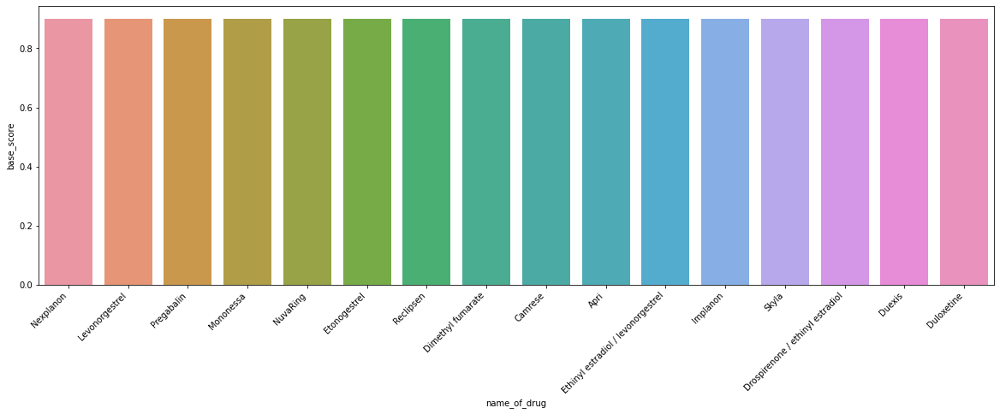

In [0]:
ax = bar_plot(name_basescore_data['name_of_drug'][-20:], name_basescore_data['base_score'][-20:])

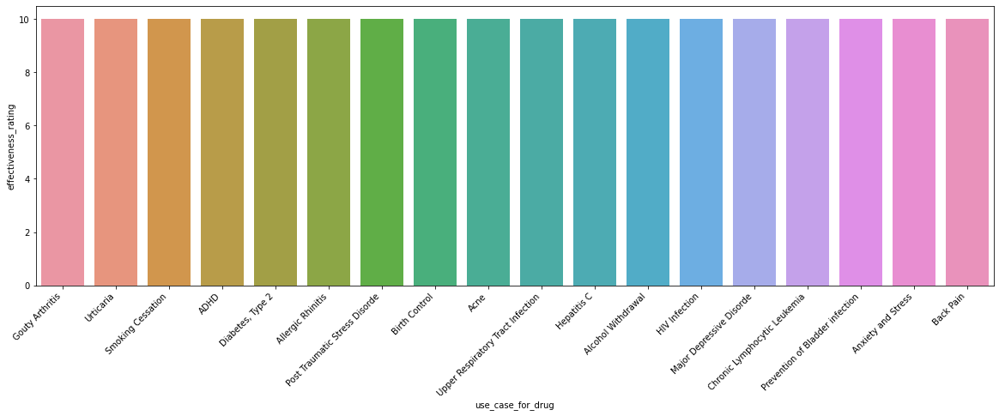

In [0]:
# top 20 use_cases based on effectiveness rating
use_rating_data = drug_data_temp[['use_case_for_drug', 'effectiveness_rating']].sort_values('effectiveness_rating', ascending = False)
ax = bar_plot(use_rating_data['use_case_for_drug'][:20], use_rating_data['effectiveness_rating'][:20])

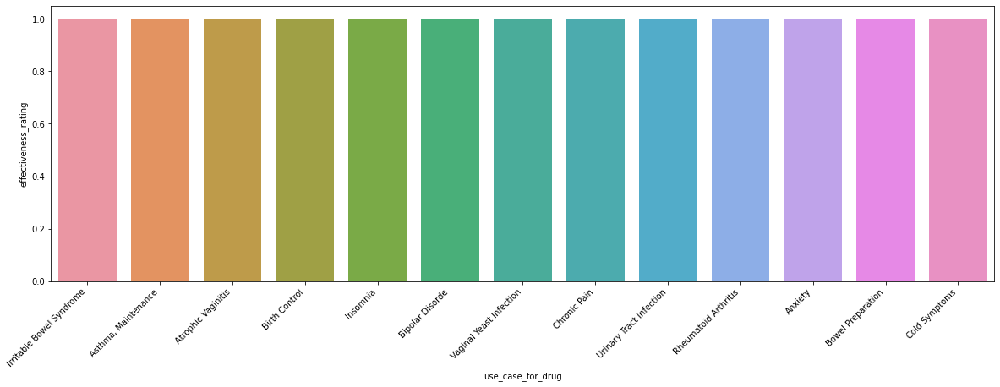

In [0]:
# bottom 20 use_cases based on effectiveness rating
ax = bar_plot(use_rating_data['use_case_for_drug'][-20:], use_rating_data['effectiveness_rating'][-20:])

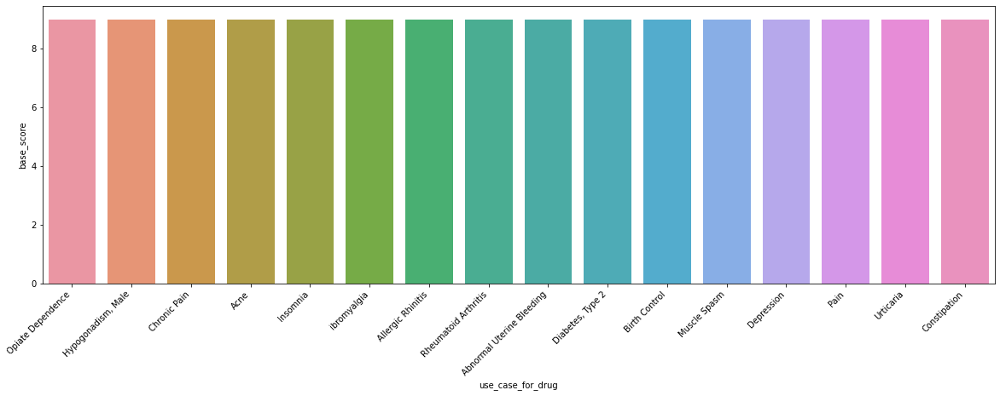

In [0]:
# top 20 use_cases based on base_score
use_basescore_data = drug_data_temp[['use_case_for_drug', 'base_score']].sort_values('base_score', ascending = False)
ax = bar_plot(use_basescore_data['use_case_for_drug'][:20], use_basescore_data['base_score'][:20])

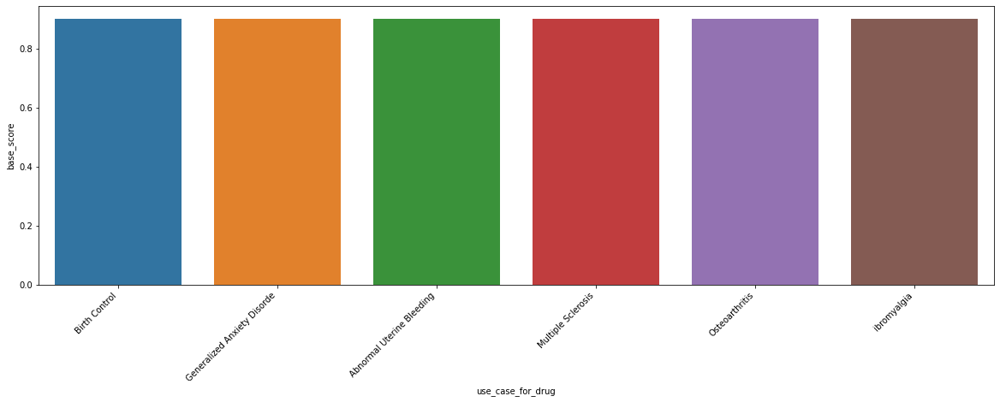

In [0]:
# bottom 20 use_cases based on base_score
ax = bar_plot(use_basescore_data['use_case_for_drug'][-20:], use_basescore_data['base_score'][-20:])

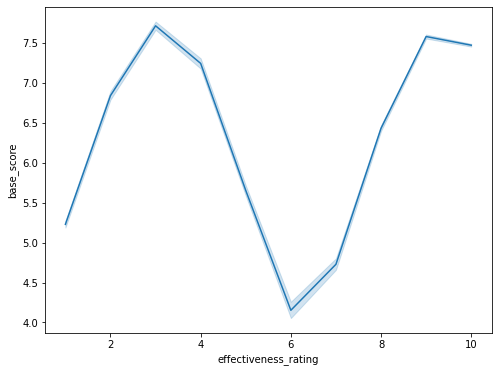

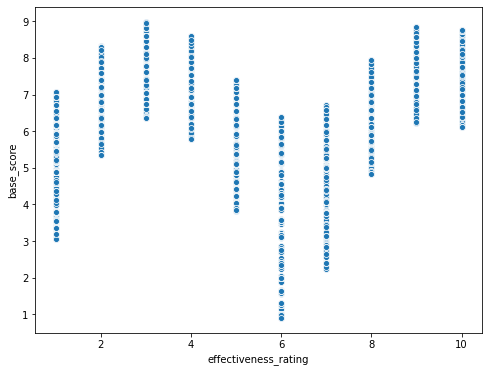

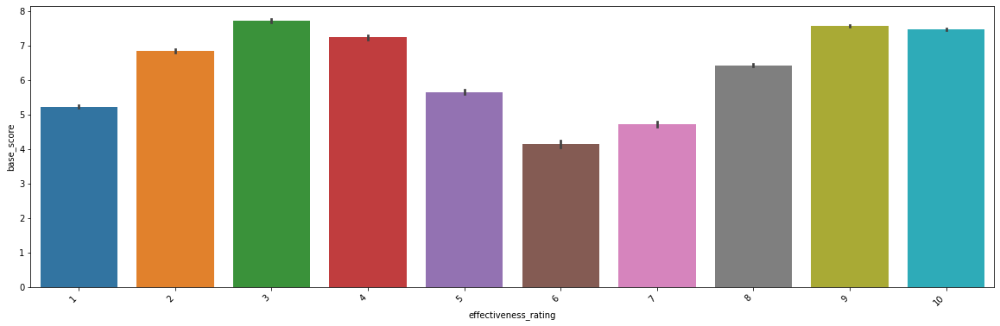

In [0]:
# effectiveness rating vs base_score
line_plot(drug_data_temp['effectiveness_rating'], drug_data_temp['base_score'])
scatter_plot(drug_data_temp['effectiveness_rating'], drug_data_temp['base_score'])
bar_plot(drug_data_temp['effectiveness_rating'], drug_data_temp['base_score'])

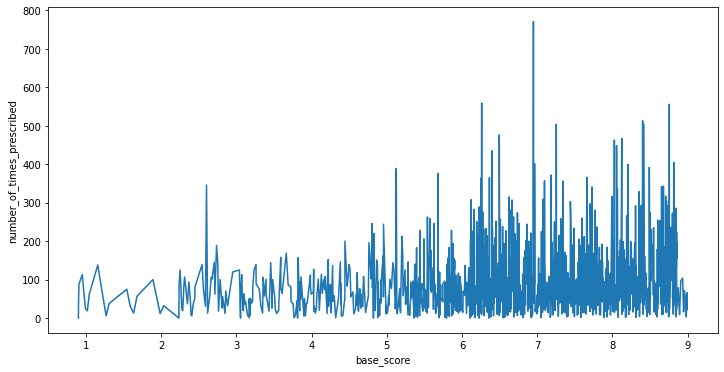

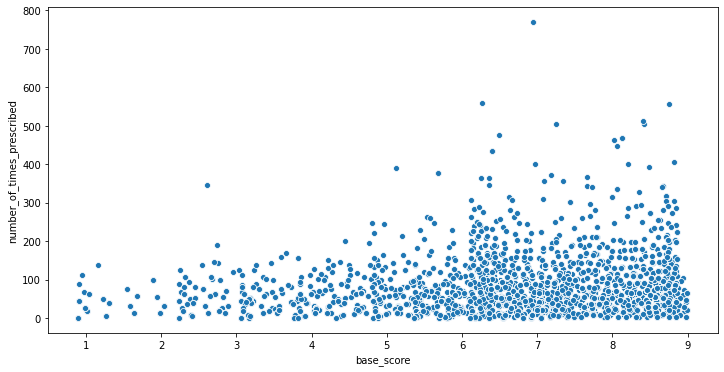

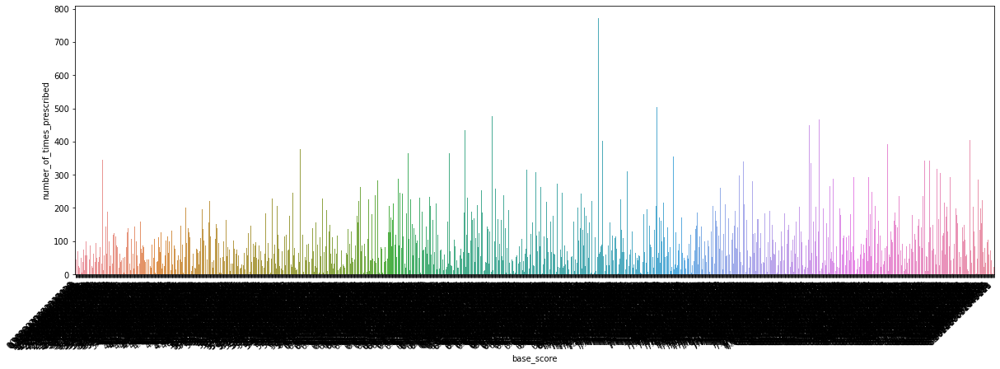

In [0]:
# base_score vs number_of_times_prescribed
line_plot(drug_data_temp['base_score'], drug_data_temp['number_of_times_prescribed'])
scatter_plot(drug_data_temp['base_score'], drug_data_temp['number_of_times_prescribed'])
bar_plot(drug_data_temp['base_score'], drug_data_temp['number_of_times_prescribed'])

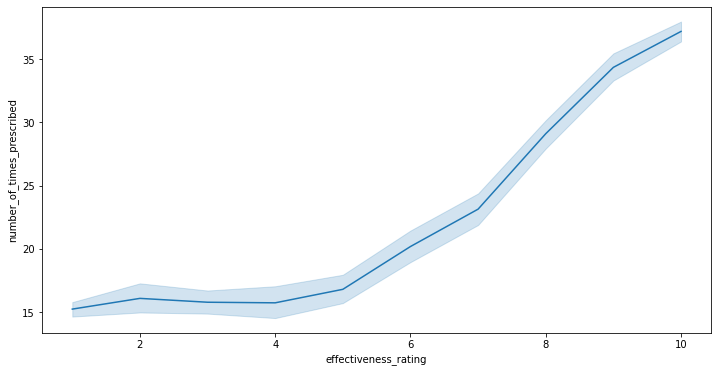

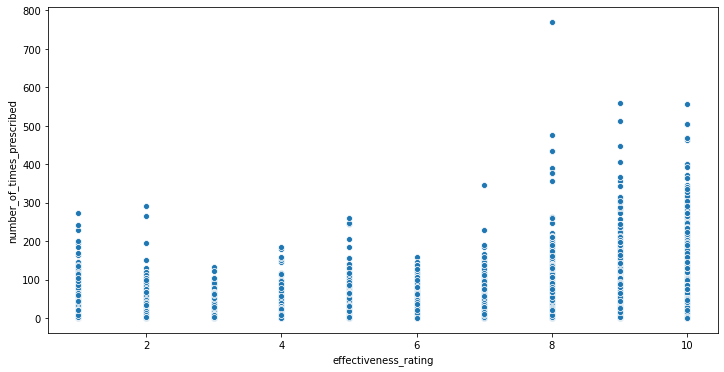

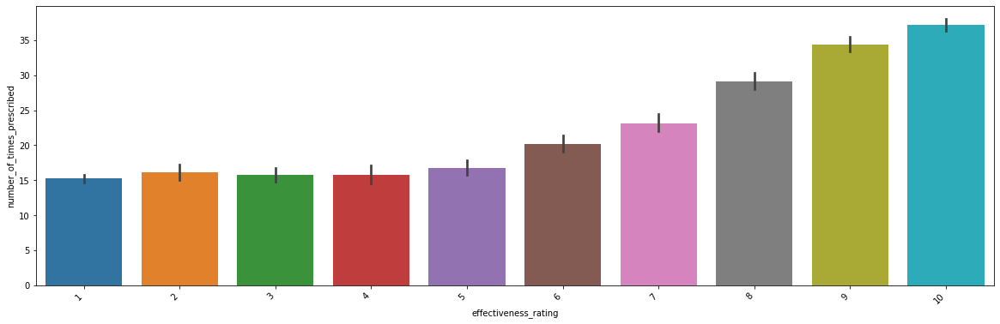

In [0]:
# effectiveness_rating vs number_of_times_prescribed
line_plot(drug_data_temp['effectiveness_rating'], drug_data_temp['number_of_times_prescribed'])
scatter_plot(drug_data_temp['effectiveness_rating'], drug_data_temp['number_of_times_prescribed'])
bar_plot(drug_data_temp['effectiveness_rating'], drug_data_temp['number_of_times_prescribed'])

## Analyzing Reviews

In [0]:
reviews = drug_data_temp['review_by_patient']
for i in range(2):
    print(reviews[i])

"It has no side effect, I take it in combination of Bystolic 5 Mg and Fish Oil"
"My son is halfway through his fourth week of Intuniv. We became concerned when he began this last week, when he started taking the highest dose he will be on. For two days, he could hardly get out of bed, was very cranky, and slept for nearly 8 hours on a drive home from school vacation (very unusual for him.) I called his doctor on Monday morning and she said to stick it out a few days. See how he did at school, and with getting up in the morning. The last two days have been problem free. He is MUCH more agreeable than ever. He is less emotional (a good thing), less cranky. He is remembering all the things he should. Overall his behavior is better. 
We have tried many different medications and so far this is the most effective."


In [0]:
review_text_uncleaned = ' '.join(reviews)
review_text_uncleaned

'"It has no side effect, I take it in combination of Bystolic 5 Mg and Fish Oil" "My son is halfway through his fourth week of Intuniv. We became concerned when he began this last week, when he started taking the highest dose he will be on. For two days, he could hardly get out of bed, was very cranky, and slept for nearly 8 hours on a drive home from school vacation (very unusual for him.) I called his doctor on Monday morning and she said to stick it out a few days. See how he did at school, and with getting up in the morning. The last two days have been problem free. He is MUCH more agreeable than ever. He is less emotional (a good thing), less cranky. He is remembering all the things he should. Overall his behavior is better. \r\nWe have tried many different medications and so far this is the most effective." "I used to take another oral contraceptive, which had 21 pill cycle, and was very happy- very light periods, max 5 days, no other side effects. But it contained hormone gestod

In [0]:
len(review_text_uncleaned)

14759980

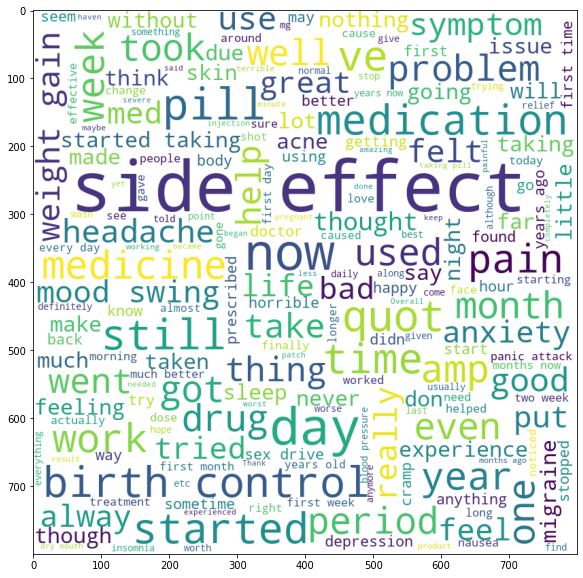

In [0]:
print_wordcloud(review_text_uncleaned)

In [0]:
len(reviews)

32165

In [0]:
# # # check function on a random index
# while True:
#     num = int((np.random.randn() * 10e9) % len(reviews))
#     print(num, reviews[num])
#     clean(reviews[num])

In [0]:
cleaned_reviews = [clean(i) for i in reviews]
review_text_cleaned = ' '.join(cleaned_reviews)
review_text_cleaned

' no side effect take combination bystolic 5 mg fish oil my son halfway fourth week intuniv became concerned began last week started taking highest dose will on two days hardly bed cranky slept nearly 8 hours drive home school vacation very unusual him called doctor monday morning said stick days see school getting morning last two days problem free much agreeable ever less emotional a good thing less cranky remembering things should overall behavior better tried many different medications far effective  used take another oral contraceptive 21 pill cycle happy light periods max 5 days no side effects contained hormone gestodene not available us switched lybrel ingredients similar pills ended started lybrel immediately first day period instructions said period lasted two weeks taking second pack two weeks now third pack things got even worse third period lasted two weeks now end third week still daily brown discharge.\r\nthe positive side didnt side effects idea period free tempting ala

In [0]:
freq = nltk.FreqDist(review_text_cleaned.split())
freq.most_common(15)

[('not', 16745),
 ('no', 11871),
 ('now', 10963),
 ('day', 10912),
 ('side', 10523),
 ('taking', 10309),
 ('years', 9307),
 ('first', 8928),
 ('pain', 8848),
 ('effects', 8806),
 ('take', 8753),
 ('started', 8484),
 ('months', 8469),
 ('days', 8076),
 ('time', 7587)]

In [0]:
# taking upto 3 grams for analysis
ngrams_dict = {}
for i in range(1, 4):
    ngrams_dict[i] = [g for g in ngrams(review_text_cleaned.split(), n=i)]

In [0]:
ngram_counts = []
for i in ngrams_dict.keys():
    count_dict = {}
    for val in ngrams_dict[i]:
        if val in count_dict:
            count_dict[val] += 1
        else:
            count_dict[val] = 1
    sorted_count_dict = dict(sorted(count_dict.items(), key = lambda kv:(kv[1], kv[0]), reverse = True))
    ngram_counts.append(sorted_count_dict)

Bar plot for most common 1-grams



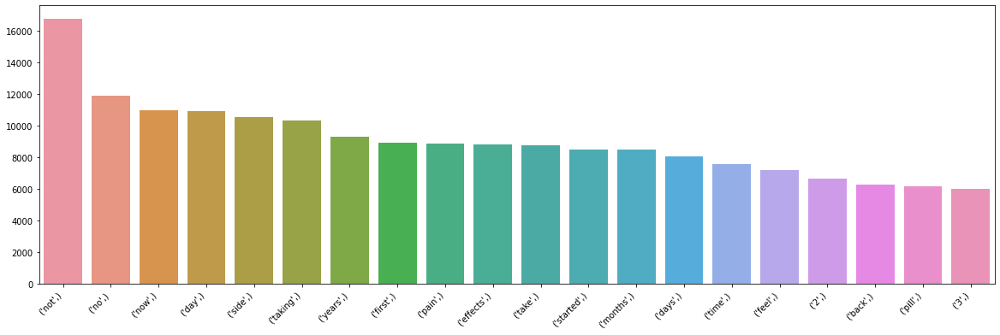

In [0]:
# 1-gram
print('Bar plot for most common 1-grams\n')
bar_plot([str(i) for i in list(ngram_counts[0].keys())[:20]], list(ngram_counts[0].values())[:20])

Bar plot for most common 2-grams



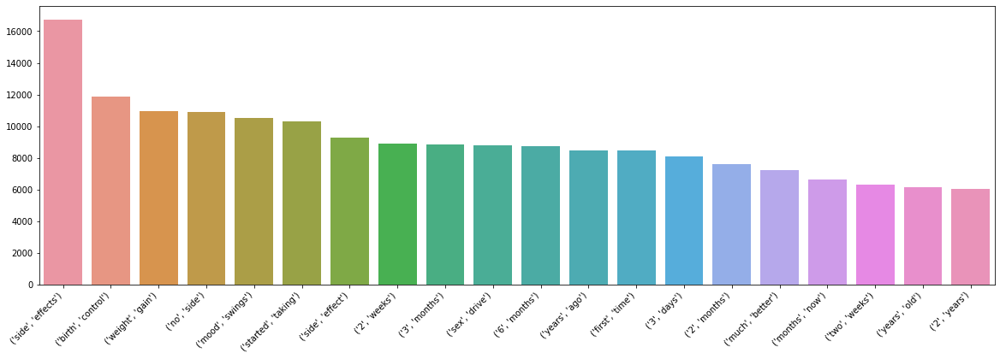

In [0]:
# 2-gram
print('Bar plot for most common 2-grams\n')
bar_plot([str(i) for i in list(ngram_counts[1].keys())[:20]], list(ngram_counts[0].values())[:20])

Bar plot for most common 3-grams



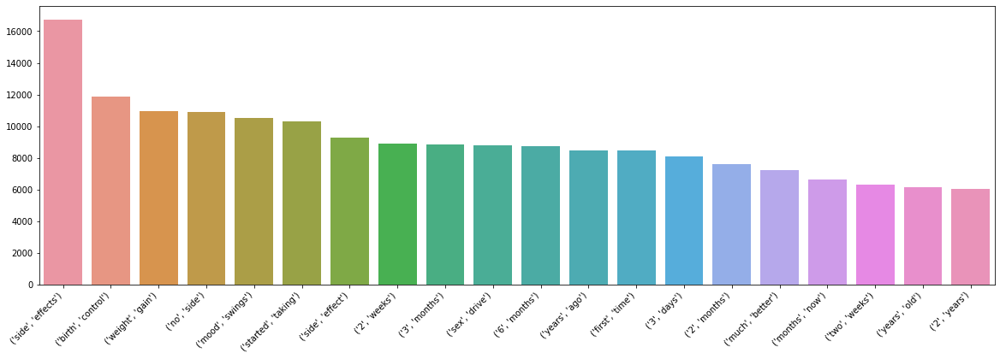

In [0]:
# 3-gram
print('Bar plot for most common 3-grams\n')
bar_plot([str(i) for i in list(ngram_counts[1].keys())[:20]], list(ngram_counts[0].values())[:20])

## Including drug name and use case

In [0]:
for i in drug_data_temp['use_case_for_drug'].unique():
    if '</span> users found this comment helpful.' in i:
        drug_data_temp['use_case_for_drug'].replace(i, '<UKN>', inplace = True)
drug_data_temp.head()

,name_of_drug,use_case_for_drug,review_by_patient,effectiveness_rating,number_of_times_prescribed,base_score
0,Valsartan,Left Ventricular Dysfunction,"""It has no side effect, I take it in combinati...",9,27,8.022969
1,Guanfacine,ADHD,"""My son is halfway through his fourth week of ...",8,192,7.858458
2,Lybrel,Birth Control,"""I used to take another oral contraceptive, wh...",5,17,6.341969
3,Buprenorphine / naloxone,Opiate Dependence,"""Suboxone has completely turned my life around...",9,37,6.590176
4,Cialis,Benign Prostatic Hyperplasia,"""2nd day on 5mg started to work with rock hard...",2,43,6.144782


In [0]:
# grouping data by use case
grouped_use_case_data = drug_data_temp.groupby(['use_case_for_drug']).mean()
grouped_use_case_data.head()

,effectiveness_rating,number_of_times_prescribed,base_score
use_case_for_drug,,,
<UKN>,6.659218,12.100559,6.591626
ADHD,7.448166,34.318979,6.736662
Abnormal Uterine Bleeding,4.163170,14.174825,5.984110
Acetaminophen Overdose,9.000000,14.000000,7.475097
Acne,7.345141,16.913715,6.802524


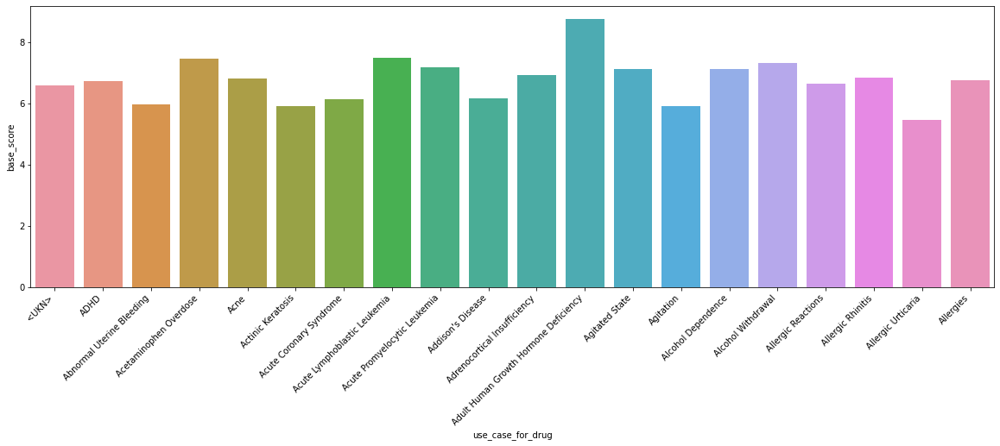

In [0]:
bar_plot(grouped_use_case_data.index[:20], grouped_use_case_data['base_score'][:20])

In [0]:
get_data_info(grouped_use_case_data)

Data has 598 rows and 3 columns



,Column,Unique Entries,Null Entries,Data Type,Min,Max,Mean,Std Dev
0,effectiveness_rating,267,0,float64,1.000000,10.000000,7.324107,2.140935
1,number_of_times_prescribed,408,0,float64,0.000000,176.000000,23.575850,20.569339
2,base_score,548,0,float64,1.632839,8.844809,6.690747,1.000776


In [0]:
# grouping data by drug name
grouped_drug_name_data = drug_data_temp.groupby(['name_of_drug']).mean()
grouped_drug_name_data.head()

,effectiveness_rating,number_of_times_prescribed,base_score
name_of_drug,,,
Abacavir / dolutegravir / lamivudine,8.857143,11.714286,5.908076
Abatacept,10.000000,71.000000,7.942854
Abilify,6.259740,40.038961,6.333860
Abilify Discmelt,8.000000,8.000000,6.785657
Abiraterone,10.000000,57.000000,6.268535


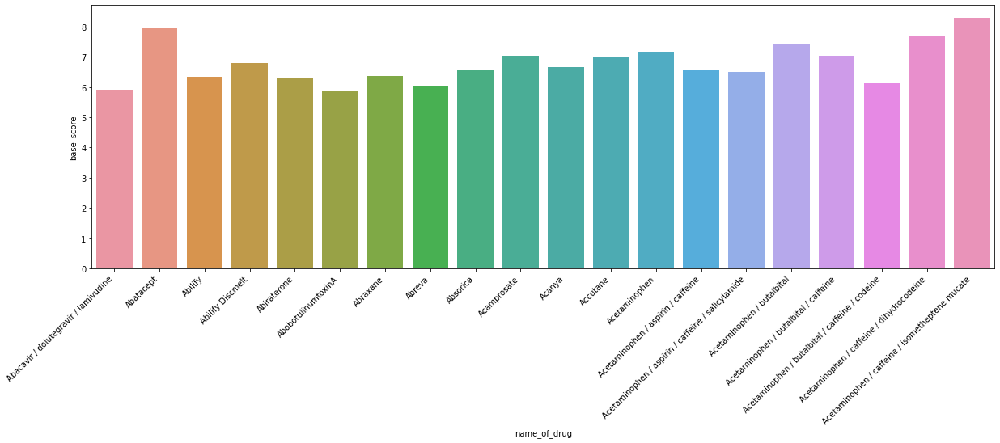

In [0]:
bar_plot(grouped_drug_name_data.index[:20], grouped_drug_name_data['base_score'][:20])

In [0]:
get_data_info(grouped_drug_name_data)

Data has 2220 rows and 3 columns



,Column,Unique Entries,Null Entries,Data Type,Min,Max,Mean,Std Dev
0,effectiveness_rating,568,0,float64,1.000000,10.000000,7.297833,2.378522
1,number_of_times_prescribed,1019,0,float64,0.000000,220.666667,24.563218,23.003515
2,base_score,1782,0,float64,1.268007,8.981228,6.692799,1.073379


In [0]:
# grouping data by drug name and use case
grouped_name_usecase_data = drug_data_temp.groupby(['name_of_drug', 'use_case_for_drug']).mean()
grouped_name_usecase_data.head()

effectiveness_rating  ...  base_score
name_of_drug                         use_case_for_drug                           ...            
Abacavir / dolutegravir / lamivudine HIV Infection                     8.857143  ...    5.908076
Abatacept                            Rheumatoid Arthritis             10.000000  ...    7.942854
Abilify                              <UKN>                             7.000000  ...    6.691877
                                     Agitated State                    7.714286  ...    7.097872
                                     Autism                            8.500000  ...    6.132285

[5 rows x 3 columns]

In [0]:
get_data_info(grouped_name_usecase_data)

Data has 4393 rows and 3 columns



,Column,Unique Entries,Null Entries,Data Type,Min,Max,Mean,Std Dev
0,effectiveness_rating,596,0,float64,1.000000,10.000000,7.258968,2.561386
1,number_of_times_prescribed,1330,0,float64,0.000000,345.000000,25.690317,25.628935
2,base_score,2942,0,float64,0.899076,8.981228,6.697325,1.182235


In [0]:
# grouping data by use case and drug name
grouped_usecase_name_data = drug_data_temp.groupby(['use_case_for_drug', 'name_of_drug']).mean()
grouped_usecase_name_data.head()

effectiveness_rating  ...  base_score
use_case_for_drug name_of_drug                         ...            
<UKN>             Abilify                         7.0  ...    6.691877
                  Adderall                        6.0  ...    2.397556
                  Adipex-P                       10.0  ...    6.493653
                  Advair Diskus                   8.5  ...    6.317813
                  Alesse                          7.0  ...    6.691877

[5 rows x 3 columns]

In [0]:
get_data_info(grouped_usecase_name_data)

Data has 4393 rows and 3 columns



,Column,Unique Entries,Null Entries,Data Type,Min,Max,Mean,Std Dev
0,effectiveness_rating,596,0,float64,1.000000,10.000000,7.258968,2.561386
1,number_of_times_prescribed,1330,0,float64,0.000000,345.000000,25.690317,25.628935
2,base_score,2942,0,float64,0.899076,8.981228,6.697325,1.182235


In [0]:
grouped_usecase_name_data

effectiveness_rating  ...  base_score
use_case_for_drug         name_of_drug                         ...            
<UKN>                     Abilify                         7.0  ...    6.691877
                          Adderall                        6.0  ...    2.397556
                          Adipex-P                       10.0  ...    6.493653
                          Advair Diskus                   8.5  ...    6.317813
                          Alesse                          7.0  ...    6.691877
...                                                       ...  ...         ...
mulation) (phenylephrine) Phenylephrine                   9.5  ...    8.000874
von Willebrand's Disease  Humate-P                       10.0  ...    6.109307
                          Stimate                        10.0  ...    7.426302
zen Shoulde               Diclofenac                      9.0  ...    7.010783
                          Ibuprofen                       8.0  ...    4.821589

[4393 rows x 3 columns]

## Studying relationship between effectiveness and base_score in more detail

In [0]:
effectiveness_basescore_data = drug_data_temp[['effectiveness_rating', 'base_score']]
effectiveness_basescore_data.head()

,effectiveness_rating,base_score
0,9,8.022969
1,8,7.858458
2,5,6.341969
3,9,6.590176
4,2,6.144782


In [0]:
# studying liear_reation between these
x_eff_base_data = effectiveness_basescore_data['effectiveness_rating']
y_eff_base_data = effectiveness_basescore_data['base_score']
x_train_eff_base_data, x_test_eff_base_data, y_train_eff_base_data, y_test_eff_base_data = train_test_split(x_eff_base_data, y_eff_base_data, random_state = 0)
x_train_eff_base_data = np.array(x_train_eff_base_data).reshape(-1, 1)
x_test_eff_base_data = np.array(x_test_eff_base_data).reshape(-1, 1)
x_train_eff_base_data.shape, x_test_eff_base_data.shape, y_train_eff_base_data.shape, y_test_eff_base_data.shape

((24123, 1), (8042, 1), (24123,), (8042,))

In [0]:
from sklearn.linear_model import LinearRegression
lr = LinearRegression()
lr.fit(x_train_eff_base_data, y_train_eff_base_data),
print(lr.coef_, lr.intercept_)

[0.19903533] 5.278310425153897


Score on train data: 0.16791893284552906


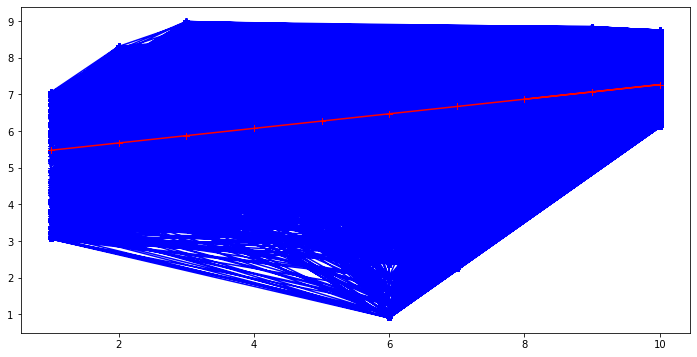

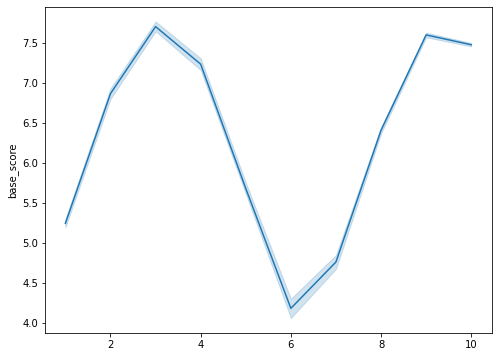

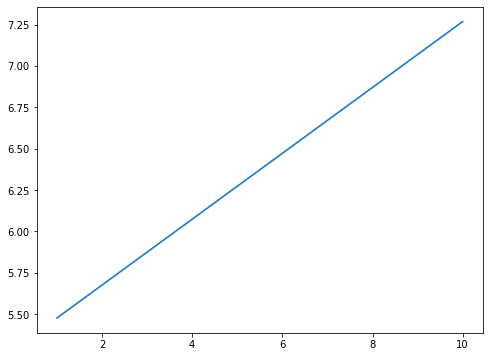

In [0]:
predict_on_train = lr.predict(x_train_eff_base_data) # predict on train first
print('Score on train data:', lr.score(x_train_eff_base_data, y_train_eff_base_data))
fig = plt.figure(figsize=(12, 6))
plt.plot(x_train_eff_base_data, y_train_eff_base_data, color = 'blue', marker='*')
plt.plot(x_train_eff_base_data, predict_on_train, color = 'red', marker='+')
line_plot(x_train_eff_base_data.reshape(-1), y_train_eff_base_data)
line_plot(x_train_eff_base_data.reshape(-1), predict_on_train)
plt.show()

Score on test data: 0.17585345075836445


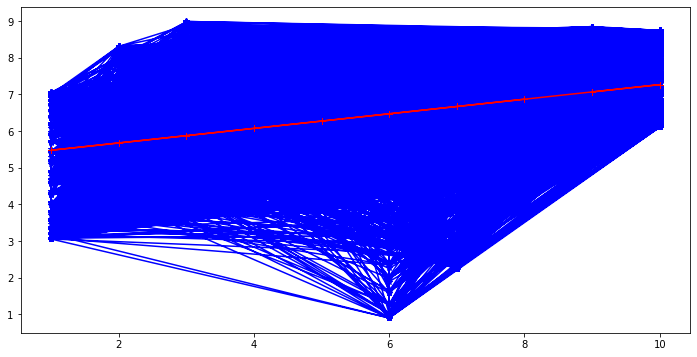

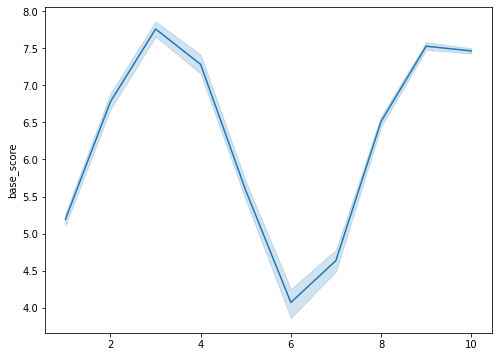

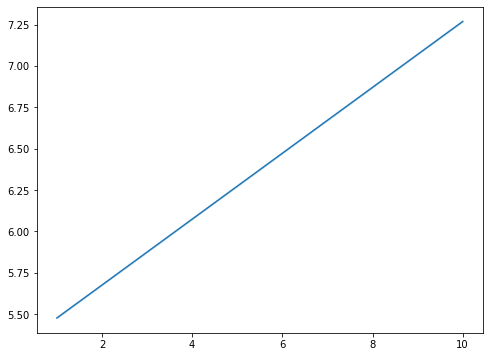

In [0]:
# test Linear Regression Model
predict_on_test = lr.predict(x_test_eff_base_data) # predict on train first
print('Score on test data:', lr.score(x_test_eff_base_data, y_test_eff_base_data))
fig = plt.figure(figsize=(12, 6))
plt.plot(x_test_eff_base_data, y_test_eff_base_data, color = 'blue', marker='*')
plt.plot(x_test_eff_base_data, predict_on_test, color = 'red', marker='+')
line_plot(x_test_eff_base_data.reshape(-1), y_test_eff_base_data)
line_plot(x_test_eff_base_data.reshape(-1), predict_on_test)
plt.show()

In [0]:
# gradient boosting regressor
from sklearn.ensemble import GradientBoostingRegressor
gb = GradientBoostingRegressor(max_depth=10)
gb.fit(x_train_eff_base_data, y_train_eff_base_data)

GradientBoostingRegressor(alpha=0.9, ccp_alpha=0.0, criterion='friedman_mse',
                          init=None, learning_rate=0.1, loss='ls', max_depth=10,
                          max_features=None, max_leaf_nodes=None,
                          min_impurity_decrease=0.0, min_impurity_split=None,
                          min_samples_leaf=1, min_samples_split=2,
                          min_weight_fraction_leaf=0.0, n_estimators=100,
                          n_iter_no_change=None, presort='deprecated',
                          random_state=None, subsample=1.0, tol=0.0001,
                          validation_fraction=0.1, verbose=0, warm_start=False)

Score on train data: 0.4736812161486279


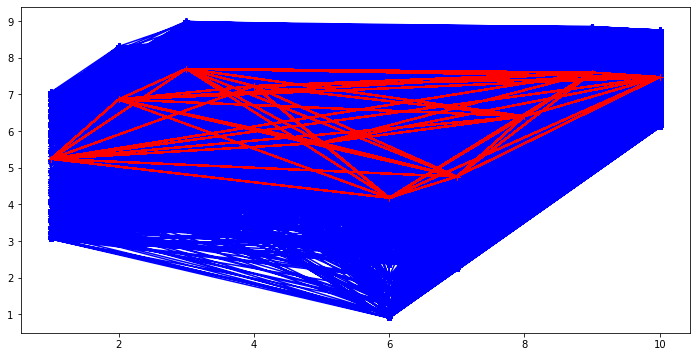

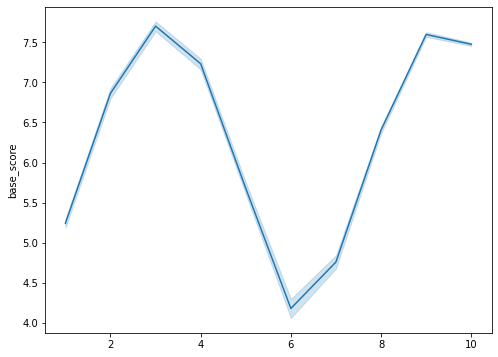

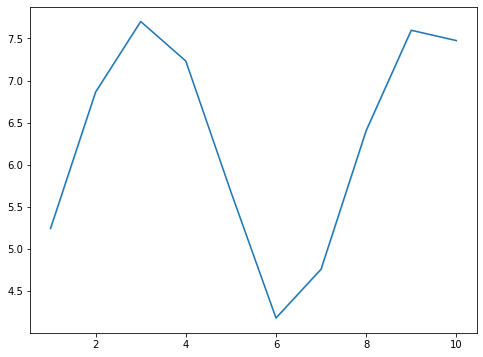

In [0]:
predict_on_train = gb.predict(x_train_eff_base_data) # predict on train first
print('Score on train data:', gb.score(x_train_eff_base_data, y_train_eff_base_data))
fig = plt.figure(figsize=(12, 6))
plt.plot(x_train_eff_base_data, y_train_eff_base_data, color = 'blue', marker='*')
plt.plot(x_train_eff_base_data, predict_on_train, color = 'red', marker='+')
line_plot(x_train_eff_base_data.reshape(-1), y_train_eff_base_data)
line_plot(x_train_eff_base_data.reshape(-1), predict_on_train)
plt.show()

Score on test data: 0.4853503088146533


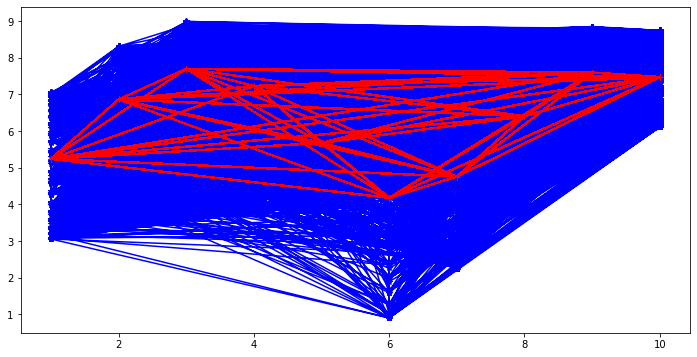

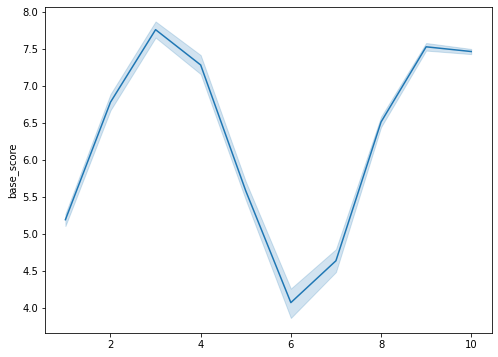

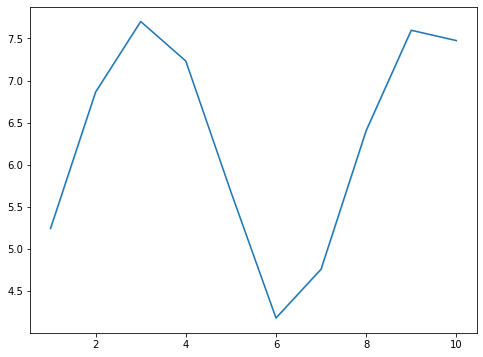

In [0]:
# test Gradient Boosting Regressor
predict_on_test = gb.predict(x_test_eff_base_data) # predict on train first
print('Score on test data:', gb.score(x_test_eff_base_data, y_test_eff_base_data))
fig = plt.figure(figsize=(12, 6))
plt.plot(x_test_eff_base_data, y_test_eff_base_data, color = 'blue', marker='*')
plt.plot(x_test_eff_base_data, predict_on_test, color = 'red', marker='+')
line_plot(x_test_eff_base_data.reshape(-1), y_test_eff_base_data)
line_plot(x_test_eff_base_data.reshape(-1), predict_on_test)
plt.show()

### Adding extra feature of number_of_times_prescribed

In [0]:
effectiveness_num_basescore_data = drug_data_temp[['effectiveness_rating', 'number_of_times_prescribed', 'base_score']]
effectiveness_num_basescore_data.head()

,effectiveness_rating,number_of_times_prescribed,base_score
0,9,27,8.022969
1,8,192,7.858458
2,5,17,6.341969
3,9,37,6.590176
4,2,43,6.144782


In [0]:
# studying liear_reation between these
x_eff_num_base_data = effectiveness_num_basescore_data[['effectiveness_rating', 'number_of_times_prescribed']]
y_eff_num_base_data = effectiveness_num_basescore_data['base_score']
x_train_eff_num_base_data, x_test_eff_num_base_data, y_train_eff_num_base_data, y_test_eff_num_base_data = train_test_split(x_eff_num_base_data, y_eff_num_base_data, random_state = 0)
# x_train_eff_base_data = np.array(x_train_eff_base_data).reshape(-1, 1)
# x_test_eff_base_data = np.array(x_test_eff_base_data).reshape(-1, 1)
x_train_eff_num_base_data.shape, x_test_eff_num_base_data.shape, y_train_eff_num_base_data.shape, y_test_eff_num_base_data.shape

((24123, 2), (8042, 2), (24123,), (8042,))

Score on train data: 0.16906023475607057


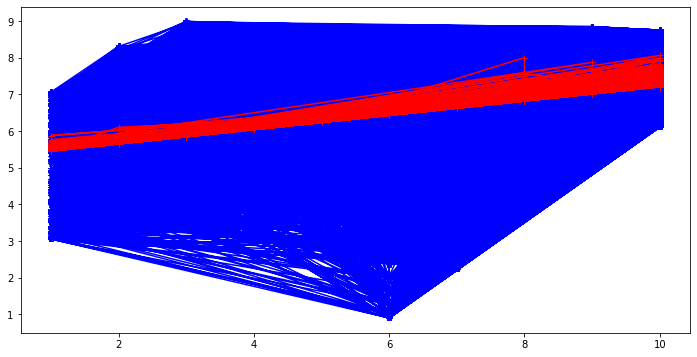

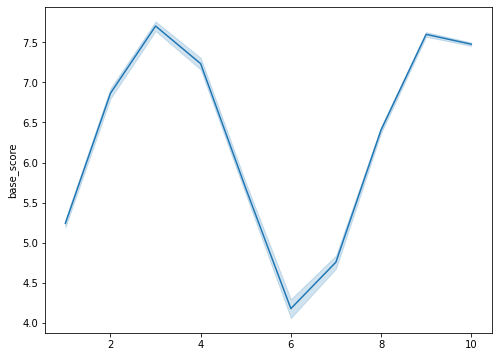

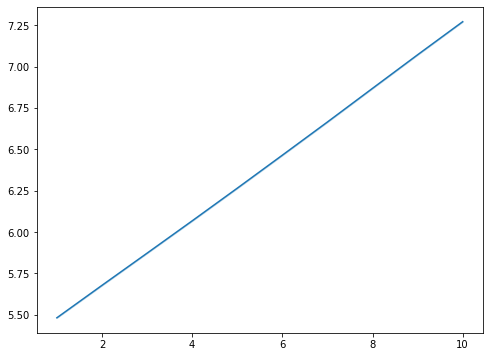

In [0]:
lr.fit(x_train_eff_num_base_data, y_train_eff_num_base_data)
predict_on_train = lr.predict(x_train_eff_num_base_data) # predict on train first
print('Score on train data:', lr.score(x_train_eff_num_base_data, y_train_eff_num_base_data))
fig = plt.figure(figsize=(12, 6))
plt.plot(x_train_eff_base_data, y_train_eff_num_base_data, color = 'blue', marker='*')
plt.plot(x_train_eff_base_data, predict_on_train, color = 'red', marker='+')
line_plot(x_train_eff_base_data.reshape(-1), y_train_eff_num_base_data)
line_plot(x_train_eff_base_data.reshape(-1), predict_on_train)
plt.show()

Score on test data: 0.17745175149338843


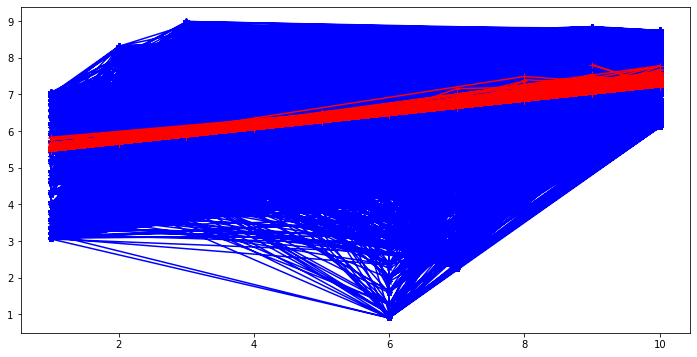

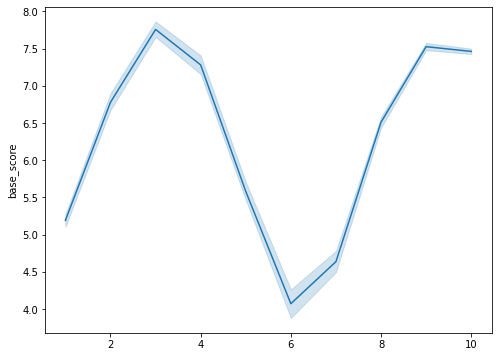

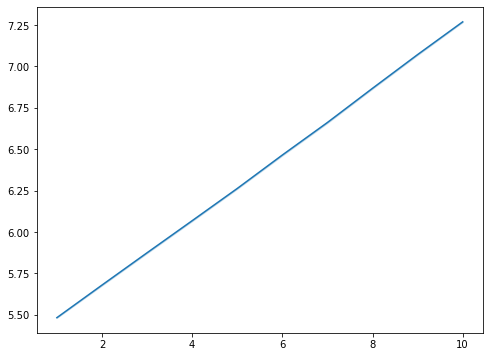

In [0]:
# test Linear Regression Model
predict_on_test = lr.predict(x_test_eff_num_base_data) # predict on train first
print('Score on test data:', lr.score(x_test_eff_num_base_data, y_test_eff_num_base_data))
fig = plt.figure(figsize=(12, 6))
plt.plot(x_test_eff_base_data, y_test_eff_num_base_data, color = 'blue', marker='*')
plt.plot(x_test_eff_base_data, predict_on_test, color = 'red', marker='+')
line_plot(x_test_eff_base_data.reshape(-1), y_test_eff_num_base_data)
line_plot(x_test_eff_base_data.reshape(-1), predict_on_test)
plt.show()

Score on train data: 0.9976300809419582


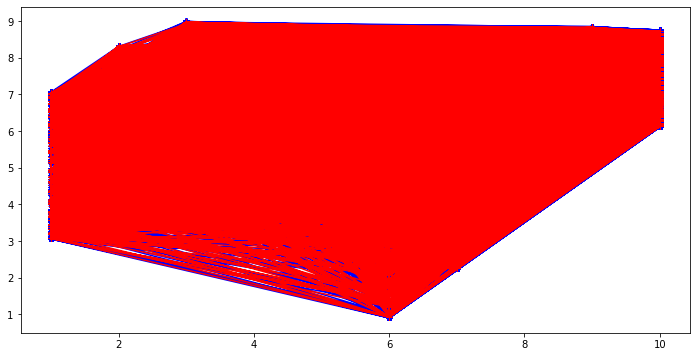

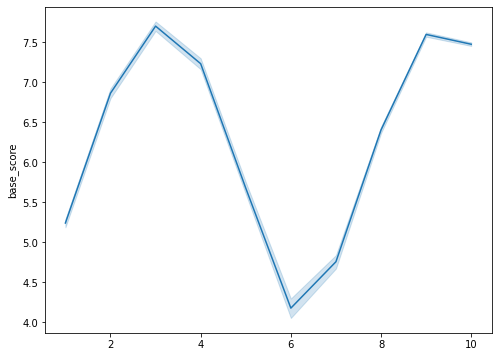

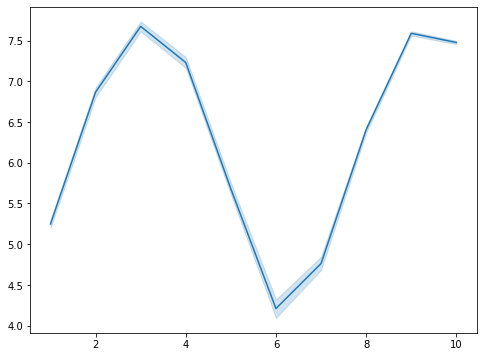

In [0]:
gb.fit(x_train_eff_num_base_data, y_train_eff_num_base_data)
predict_on_train = gb.predict(x_train_eff_num_base_data) # predict on train first
print('Score on train data:', gb.score(x_train_eff_num_base_data, y_train_eff_num_base_data))
fig = plt.figure(figsize=(12, 6))
plt.plot(x_train_eff_base_data, y_train_eff_num_base_data, color = 'blue', marker='*')
plt.plot(x_train_eff_base_data, predict_on_train, color = 'red', marker='+')
line_plot(x_train_eff_base_data.reshape(-1), y_train_eff_num_base_data)
line_plot(x_train_eff_base_data.reshape(-1), predict_on_train)
plt.show()

Score on test data: 0.9953295830679062


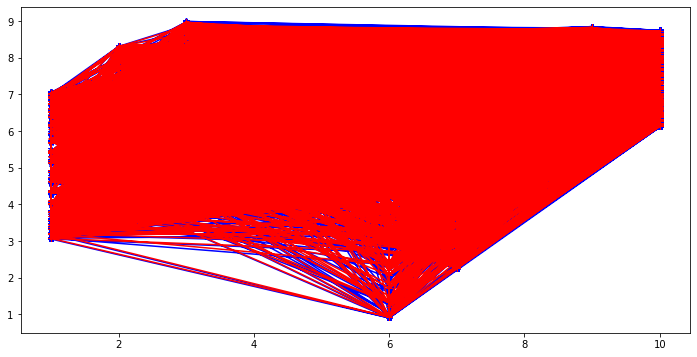

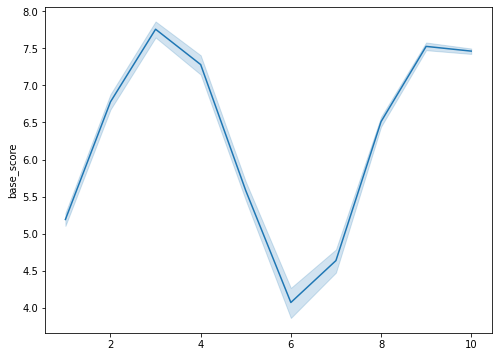

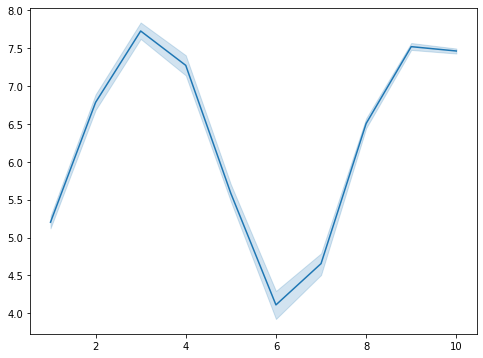

In [0]:
# test Gradient Boosting Regressor
predict_on_test = gb.predict(x_test_eff_num_base_data) # predict on train first
print('Score on test data:', gb.score(x_test_eff_num_base_data, y_test_eff_num_base_data))
fig = plt.figure(figsize=(12, 6))
plt.plot(x_test_eff_base_data, y_test_eff_num_base_data, color = 'blue', marker='*')
plt.plot(x_test_eff_base_data, predict_on_test, color = 'red', marker='+')
line_plot(x_test_eff_base_data.reshape(-1), y_test_eff_num_base_data)
line_plot(x_test_eff_base_data.reshape(-1), predict_on_test)
plt.show()

## Label and One Hot encoding

### Using other parameters also to predict base_score directly -> Label Encoding

In [0]:
x_train = train_data_copy.drop(['base_score', 'review_by_patient'], axis = 1)
y_train = train_data_copy['base_score']
x_train.head()

NameError: ignored

In [0]:
le_name = LabelEncoder()
le_usecase = LabelEncoder()
name_labels = le_name.fit_transform(x_train['name_of_drug'])
use_case_labels = le_usecase.fit_transform(x_train['use_case_for_drug'])
x_train['name_labels'] = name_labels
x_train['use_case_labels'] = use_case_labels
x_train.drop(['name_of_drug', 'use_case_for_drug'], axis = 1, inplace = True)
x_train.head()

In [0]:
# add label 'other' to le_name and le_usecase
le_name_classes = le_name.classes_.tolist()
le_name_classes += ['other']
le_name.classes_ = le_name_classes

le_usecase_classes = le_usecase.classes_.tolist()
le_usecase_classes += ['other']
le_usecase.classes_ = le_name_classes

In [0]:
x_test = test_data_copy.drop(['review_by_patient', 'number_of_times_prescribed'], axis = 1)
x_test['number_of_times_prescribed'] = test_data_copy['number_of_times_prescribed']

# handling unseen labels
x_test['use_case_for_drug'] = x_test['use_case_for_drug'].map(lambda s: 'other' if s not in le_usecase.classes_ else s)
x_test['name_of_drug'] = x_test['name_of_drug'].map(lambda s: 'other' if s not in le_name.classes_ else s)

x_test['use_case_labels'] = le_usecase.transform(x_test['use_case_for_drug'])
x_test['name_labels'] = le_name.transform(x_test['name_of_drug'])

x_test.drop(['name_of_drug', 'use_case_for_drug'], axis = 1, inplace = True)
x_test.head()

In [0]:
x_train.shape, y_train.shape, x_test.shape

### Using other parameters also to predict base_score directly -> One Hot Encoding

In [0]:
for i in train_data_copy['use_case_for_drug'].unique():
    if '</span> users found this comment helpful.' in i:
        train_data_copy['use_case_for_drug'].replace(i, '<UKN>', inplace = True)

In [0]:
for i in test_data_temp['use_case_for_drug'].unique():
    if '</span> users found this comment helpful.' in i:
        test_data_temp['use_case_for_drug'].replace(i, '<UKN>', inplace = True)

In [0]:
x_train = train_data_copy.drop(['base_score', 'review_by_patient'], axis = 1)
x_train['patient_id'] = drug_data_train['patient_id']
y_train = train_data_copy['base_score']

In [0]:
one_hot_name = OneHotEncoder()
name_labels = one_hot_name.fit_transform(np.array(x_train['name_of_drug']).reshape(-1, 1)).toarray()
df_name_labels = pd.DataFrame(name_labels, columns = one_hot_name.categories_[0])
df_name_labels['patient_id'] = drug_data_train['patient_id']

x_train = pd.merge(x_train, df_name_labels, on='patient_id')

one_hot_usecase = OneHotEncoder()
use_case_labels = one_hot_usecase.fit_transform(np.array(x_train['use_case_for_drug']).reshape(-1, 1)).toarray()
df_use_case_labels = pd.DataFrame(use_case_labels, columns = one_hot_usecase.categories_[0])
df_use_case_labels['patient_id'] = drug_data_train['patient_id']

x_train = pd.merge(x_train, df_use_case_labels, on='patient_id')
x_train.drop(['patient_id'], inplace = True, axis = 1)
x_train.head()

### Using pd.get_dummies()

In [0]:
x_train = train_data_copy.drop(['base_score', 'review_by_patient'], axis = 1)
y_train = train_data_copy['base_score']
x_train.shape, y_train.shape

In [0]:
x_test = test_data_temp.copy()
x_test.drop(['review_by_patient', 'number_of_times_prescribed'], axis = 1, inplace = True)
x_test['number_of_times_prescribed'] = test_data_temp['number_of_times_prescribed']
x_test.shape

In [0]:
# get dummies for use_Case
use_case_comb = pd.concat([x_train['use_case_for_drug'], x_test['use_case_for_drug']])
use_case_dummies = pd.get_dummies(use_case_comb)
use_case_train, use_case_test = use_case_dummies.iloc[:x_train.shape[0]], use_case_dummies[x_train.shape[0]:]
use_case_dummies.shape, use_case_train.shape, use_case_test.shape

In [0]:
# get dummies for name_of_drug
name_comb = pd.concat([x_train['name_of_drug'], x_test['name_of_drug']])
name_dummies = pd.get_dummies(name_comb)
name_train, name_test = name_dummies.iloc[:x_train.shape[0]], name_dummies[x_train.shape[0]:]
name_dummies.shape, name_train.shape, name_test.shape

In [0]:
x_train['patient_id'] = drug_data_train['patient_id']
use_case_train['patient_id'] = drug_data_train['patient_id']
name_train['patient_id'] = drug_data_train['patient_id']
x_train = pd.merge(x_train, use_case_train, on='patient_id')
x_train = pd.merge(x_train, name_train, on = 'patient_id')
x_train.drop(['patient_id', 'name_of_drug', 'use_case_for_drug'], axis = 1, inplace = True)
x_train.shape

In [0]:
x_test['patient_id'] = test_data_master['patient_id']
use_case_test['patient_id'] = test_data_master['patient_id']
name_test['patient_id'] = test_data_master['patient_id']
x_test = pd.merge(x_test, use_case_test, on='patient_id')
x_test = pd.merge(x_test, name_test, on = 'patient_id')
x_test.drop(['patient_id', 'name_of_drug', 'use_case_for_drug'], axis = 1, inplace = True)
x_test.shape

## Preparing data for LSTM model

In [0]:
drug_data_temp.columns, test_data_temp.columns

(Index(['name_of_drug', 'use_case_for_drug', 'review_by_patient',
        'effectiveness_rating', 'number_of_times_prescribed', 'base_score'],
       dtype='object'),
 Index(['name_of_drug', 'review_by_patient', 'number_of_times_prescribed',
        'use_case_for_drug', 'effectiveness_rating'],
       dtype='object'))

In [0]:
train_data_copy = drug_data_temp.copy()
test_data_copy = test_data_temp.copy()
train_data_copy.shape, test_data_copy.shape

((32165, 6), (10760, 5))

In [0]:
train_data = train_data_copy.drop(['effectiveness_rating', 'number_of_times_prescribed', 'base_score'], axis = 1)
train_data_y = train_data_copy['effectiveness_rating']
test_data = test_data_copy.drop(['number_of_times_prescribed', 'effectiveness_rating', 'review_by_patient'], axis = 1)
test_data['review_by_patient'] = test_data_copy['review_by_patient']
test_data_y = test_data_copy['effectiveness_rating']
train_data.shape, train_data_y.shape, test_data.shape, test_data_y.shape

((32165, 3), (32165,), (10760, 3), (10760,))

In [0]:
for i in train_data['use_case_for_drug'].unique():
    if '</span> users found this comment helpful.' in i:
        train_data['use_case_for_drug'].replace(i, '<UKN>', inplace = True)

In [0]:
for i in test_data['use_case_for_drug'].unique():
    if '</span> users found this comment helpful.' in i:
        test_data['use_case_for_drug'].replace(i, '<UKN>', inplace = True)

In [0]:
train_data.head()

,name_of_drug,use_case_for_drug,review_by_patient
0,Valsartan,Left Ventricular Dysfunction,"""It has no side effect, I take it in combinati..."
1,Guanfacine,ADHD,"""My son is halfway through his fourth week of ..."
2,Lybrel,Birth Control,"""I used to take another oral contraceptive, wh..."
3,Buprenorphine / naloxone,Opiate Dependence,"""Suboxone has completely turned my life around..."
4,Cialis,Benign Prostatic Hyperplasia,"""2nd day on 5mg started to work with rock hard..."


In [0]:
test_data.head()

,name_of_drug,use_case_for_drug,review_by_patient
0,Mirtazapine,Depression,"""I&#039;ve tried a few antidepressants over th..."
1,Contrave,Weight Loss,"""Contrave combines drugs that were used for al..."
2,Zyclara,Keratosis,"""4 days in on first 2 weeks. Using on arms an..."
3,Methadone,Opiate Withdrawal,"""Ive been on Methadone for over ten years and ..."
4,Ambien,Insomnia,"""Ditto on rebound sleepless when discontinued...."


In [0]:
train_reviews_cleaned = [clean(i) for i in train_data['review_by_patient']]
train_reviews_cleaned[:5]

[' no side effect take combination bystolic 5 mg fish oil',
 'my son halfway fourth week intuniv became concerned began last week started taking highest dose will on two days hardly bed cranky slept nearly 8 hours drive home school vacation very unusual him called doctor monday morning said stick days see school getting morning last two days problem free much agreeable ever less emotional a good thing less cranky remembering things should overall behavior better tried many different medications far effective',
 ' used take another oral contraceptive 21 pill cycle happy light periods max 5 days no side effects contained hormone gestodene not available us switched lybrel ingredients similar pills ended started lybrel immediately first day period instructions said period lasted two weeks taking second pack two weeks now third pack things got even worse third period lasted two weeks now end third week still daily brown discharge.\r\nthe positive side didnt side effects idea period free tem

In [0]:
test_reviews_cleaned = [clean(i) for i in test_data['review_by_patient']]
test_reviews_cleaned[:5]

[' tried antidepressants years citalopram fluoxetine amitriptyline none helped depression insomnia amp anxiety doctor suggested changed onto 45mg mirtazapine medicine saved life thankfully no side effects especially common weight gain actually lost alot weight still suicidal thoughts mirtazapine saved me',
 'contrave combines drugs used alcohol smoking opioid cessation people lose weight helps control over-eating no doubt obesity caused sugar/carb addiction powerful drug taking five days good news is seems go work immediately feel hungry want food now really dont care eat fill stomach days dont know lost weight  dont scale clothes feel little looser maybe pound two hoping months medication will develop healthier habits continue without aid contrave',
 '4 days first 2 weeks using arms face put vaseline lips eyes nostrils protect cream far no reaction all know many pre cancer thought light christmas tree far good maybe coming time will tell',
 ' methadone ten years currently,i trying dru

In [0]:
train_data_x = train_data['name_of_drug'] + ' ' + train_data['use_case_for_drug'] + ' ' + np.array(train_reviews_cleaned)
train_data_x[0]

'Valsartan Left Ventricular Dysfunction  no side effect take combination bystolic 5 mg fish oil'

In [0]:
test_data_x = test_data['name_of_drug'] + ' ' + test_data['use_case_for_drug'] + ' ' + np.array(test_reviews_cleaned)
test_data_x[0]

'Mirtazapine Depression  tried antidepressants years citalopram fluoxetine amitriptyline none helped depression insomnia amp anxiety doctor suggested changed onto 45mg mirtazapine medicine saved life thankfully no side effects especially common weight gain actually lost alot weight still suicidal thoughts mirtazapine saved me'

In [0]:
train_length = len(train_data_x)
test_length = len(test_data_x)
train_length, test_length

(32165, 10760)

## Preparing LSTM Model

In [0]:
# translate text to a sequence of numbers
def encod_text(text):
    tokenizer = Tokenizer(filters='!"#$%&()*+,-./:;<=>?@[\\]^_`{|}~\t\n', split=" ", lower=True)
    tokenizer.fit_on_texts(text)
    return tokenizer, tokenizer.texts_to_sequences(text)

In [0]:
# apply padding to dataset and convert labels to bitmaps
def format_data(encoded_text, max_length, labels):
    x = pad_sequences(encoded_text, maxlen= max_length, padding='post')
    y = []
    for score in labels:
        bit_vec = np.zeros(2) # 10 classes
        bit_vec[score] = 1
        y.append(bit_vec)
    y = np.asarray(y)
    return x, y

In [0]:
# create weight matrix from pre trained embeddings
def create_weight_matrix(vocab, raw_embeddings):
    vocab_size = len(vocab) + 1
    weight_matrix = np.zeros((vocab_size, 300))
    for word, idx in vocab.items():
        if word in raw_embeddings:
            weight_matrix[idx] = raw_embeddings[word]
    return weight_matrix

In [0]:
# final model
def final_model(weight_matrix, vocab_size, max_length, x, y, x_test, y_test, epoch = 5):
    embedding_layer = Embedding(vocab_size, 300, weights=[weight_matrix], input_length=max_length, trainable=True, mask_zero=True)
    model = Sequential()
    model.add(embedding_layer)
    model.add(Bidirectional(LSTM(128, dropout=0.2, return_sequences=True)))
    model.add(Bidirectional(LSTM(128, dropout=0.2)))
    model.add(Dense(2, activation='softmax'))
    model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
    model.fit(x, y, epochs = epoch, validation_split = 0.2)
    score, acc = model.evaluate(x_test, y_test)
    return model, score, acc

In [0]:
# train_data_x = train_data_x.tolist()
# test_data_x = test_data_x.tolist()
# data_x = train_data_x + test_data_x
# len(data_x)
train_data_x = train_text.tolist()
test_data_x = test_text.tolist()
data_x = train_data_x + test_data_x
train_data_y = train_sentiment
test_data_y = test_sentiment
len(data_x), len(train_sentiment), len(test_sentiment)

(42925, 32165, 10760)

In [0]:
train_length = len(train_data_x)
test_length = len(test_data_x)
train_length, test_length

(32165, 10760)

In [0]:
tokenized_text = data_x
max_length = math.ceil(sum([len(s.split(" ")) for s in tokenized_text])/len(tokenized_text))
tokenizer, encoded_text = encod_text(tokenized_text)
max_length, len(encoded_text)

(49, 42925)

In [0]:
x_train, y_train = format_data(encoded_text[:train_length], max_length, train_data_y) # labels from 0 - 9
len(x_train), len(y_train), x_train[:5], y_train[:5]

(32165,
 32165,
 array([[ 3771,   356,  5017,   811,     2,     5,   119,    14,   774,
          2429,    43,    79,  4147,  1798,     0,     0,     0,     0,
             0,     0,     0,     0,     0,     0,     0,     0,     0,
             0,     0,     0,     0,     0,     0,     0,     0,     0,
             0,     0,     0,     0,     0,     0,     0,     0,     0,
             0,     0,     0,     0],
        [  743,   580,   158,    73,   209,   447,   434,  3093,   905,
          2222,  2257,   629,    28,  1543,   131,   191,   761,    17,
           134,   434,    85,   131,    76,    51,    17,   210,   324,
            42, 11852,   548,   172,   467,   632,    57,   133,   172,
          4098,  2394,   193,  3188,   325,  2363,    47,    66,   140,
           163,   369,    95,   224],
        [   15,  7156,   355,    12,     3,    31,  1919,   191,    31,
           402,    51,    26,     7,   182,   384,    51,    26,     4,
           524,   384,   193,    32,    61, 

In [0]:
x_test, y_test = format_data(encoded_text[train_length:], max_length, test_data_y)
len(x_test), len(y_test), x_test[:5], y_test[:5]

(10760,
 10760,
 array([[ 1320,    38,    66,   937,     9,   829,  1106,  1097,   664,
           112,    38,   168,    92,    21,    28,   709,   256,  2040,
          4726,  1320,    48,   591,    37,  1705,     2,     5,    10,
           571,  1391,    23,   116,   236,   114,  1453,    23,    39,
           746,   405,  1320,   591,    35,     0,     0,     0,     0,
             0,     0,     0,     0],
        [ 1293,  2964,    72,     7,   678,    17,    57,  2536,   859,
           293,    64,    50,   355,    20,   646,   164,   351,     4,
            41,    36,   504,   173,  2554,   149,    17,    36,   103,
           114,    23,    36,  1485,  2160,    20,    74,  8284,   328,
          1663,    51,   415,    16,    30,    34,  2492,  2550,  1712,
           438,   126,  1998,   587],
        [ 6535,  3926,    46,    17,    12,    13,    26,   106,  1047,
           202,    86,  4458,  1207,   522,  8310,  4284,   488,    95,
             2,   618,   147,   103,   140, 

In [0]:
vocab = tokenizer.word_index
vocab, len(vocab)

({'not': 1,
  'no': 2,
  'day': 3,
  'now': 4,
  'side': 5,
  'pain': 6,
  'taking': 7,
  'control': 8,
  'years': 9,
  'effects': 10,
  'birth': 11,
  'first': 12,
  '2': 13,
  'take': 14,
  'started': 15,
  'months': 16,
  'days': 17,
  'time': 18,
  '3': 19,
  'feel': 20,
  'anxiety': 21,
  'back': 22,
  'weight': 23,
  'pill': 24,
  'one': 25,
  'weeks': 26,
  'week': 27,
  'doctor': 28,
  'took': 29,
  'medication': 30,
  'period': 31,
  'got': 32,
  'month': 33,
  'will': 34,
  'me': 35,
  'dont': 36,
  'life': 37,
  'depression': 38,
  'still': 39,
  'bad': 40,
  'really': 41,
  'much': 42,
  '5': 43,
  'never': 44,
  'acne': 45,
  '4': 46,
  'better': 47,
  'medicine': 48,
  'went': 49,
  'work': 50,
  'two': 51,
  'quot': 52,
  'felt': 53,
  'well': 54,
  'every': 55,
  'didnt': 56,
  'good': 57,
  '1': 58,
  'year': 59,
  'great': 60,
  'even': 61,
  'night': 62,
  'sleep': 63,
  'go': 64,
  'ago': 65,
  'tried': 66,
  'works': 67,
  '\r': 68,
  '6': 69,
  '10': 70,
  'this':

In [0]:
raw_embeddings = KeyedVectors.load_word2vec_format(path + 'model_swm_300-6-10-low.w2v', binary=False)
raw_embeddings

In [0]:
weight_matrix = create_weight_matrix(vocab, raw_embeddings)
len(weight_matrix)

32340

In [0]:
model, score, acc = final_model(weight_matrix, len(vocab)+1, max_length, x_train, y_train, x_test, y_test, epoch = 15)
model, score, acc

Train on 25732 samples, validate on 6433 samples
Epoch 1/15
25732/25732 [==============================] - 401s 16ms/step - loss: 0.4547 - accuracy: 0.7854 - val_loss: 0.4170 - val_accuracy: 0.8055
Epoch 2/15
25732/25732 [==============================] - 391s 15ms/step - loss: 0.3241 - accuracy: 0.8611 - val_loss: 0.3924 - val_accuracy: 0.8298
Epoch 3/15
25732/25732 [==============================] - 395s 15ms/step - loss: 0.2274 - accuracy: 0.9077 - val_loss: 0.4072 - val_accuracy: 0.8329
Epoch 4/15
25732/25732 [==============================] - 399s 16ms/step - loss: 0.1522 - accuracy: 0.9401 - val_loss: 0.5426 - val_accuracy: 0.8309
Epoch 5/15
25732/25732 [==============================] - 402s 16ms/step - loss: 0.0948 - accuracy: 0.9640 - val_loss: 0.6514 - val_accuracy: 0.8215
Epoch 6/15
25732/25732 [==============================] - 402s 16ms/step - loss: 0.0638 - accuracy: 0.9766 - val_loss: 0.7237 - val_accuracy: 0.8205
Epoch 7/15
25732/25732 [==============================] -

(<keras.engine.sequential.Sequential at 0x7f202db016a0>,
 1.2501976274424769,
 0.8117100596427917)

In [0]:
model.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_2 (Embedding)      (None, 49, 300)           9702000   
_________________________________________________________________
bidirectional_3 (Bidirection (None, 49, 256)           439296    
_________________________________________________________________
bidirectional_4 (Bidirection (None, 256)               394240    
_________________________________________________________________
dense_2 (Dense)              (None, 2)                 514       
Total params: 10,536,050
Trainable params: 10,536,050
Non-trainable params: 0
_________________________________________________________________


In [0]:
y_pred = model.predict(x_test)
y_pred

array([[1.4183221e-10, 1.0000000e+00],
       [3.1639735e-07, 9.9999964e-01],
       [2.0862611e-02, 9.7913742e-01],
       ...,
       [5.8236945e-01, 4.1763055e-01],
       [1.2438487e-07, 9.9999988e-01],
       [6.1438534e-08, 9.9999988e-01]], dtype=float32)

In [0]:
test_temp['sentiment'].head()

0    1
1    1
2    0
3    1
4    0
Name: sentiment, dtype: int64

In [0]:
for pred in y_pred:
    print(np.argmax(pred), end = ' ')

1 1 1 1 0 1 1 1 0 1 1 0 1 0 1 0 0 1 0 1 1 1 0 1 0 1 1 1 1 0 1 1 1 0 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 1 0 1 1 1 1 1 0 0 0 1 0 1 1 1 1 1 1 1 0 1 0 0 1 1 1 0 0 1 0 0 1 1 1 0 1 1 0 1 1 0 1 0 1 1 1 1 1 1 1 0 1 1 1 0 1 1 1 1 1 1 0 1 0 1 1 1 1 1 0 1 1 0 1 0 0 1 1 1 1 1 1 1 0 1 1 1 0 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 1 0 1 0 0 0 0 0 0 0 1 1 1 1 0 1 1 1 0 1 1 0 1 0 1 1 0 1 1 1 0 1 1 1 1 1 1 0 0 0 0 1 1 1 1 1 1 0 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 0 1 1 0 0 1 1 1 1 1 1 0 1 1 1 1 1 1 0 1 1 0 0 0 1 1 1 1 1 1 1 1 0 0 0 1 0 1 1 1 1 0 0 1 1 1 1 1 1 1 0 1 1 1 1 1 1 0 1 1 1 0 1 0 1 1 0 0 1 1 1 0 1 1 1 0 1 0 1 1 1 1 1 1 0 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 0 1 1 0 1 1 0 0 1 0 1 1 1 1 0 0 0 0 1 1 1 1 1 0 1 1 1 1 1 1 0 1 0 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 0 0 1 1 1 1 1 1 0 1 1 0 1 1 0 1 0 1 1 0 1 1 1 0 1 1 1 1 0 1 1 1 0 1 1 0 1 1 1 1 0 0 1 1 1 1 1 0 0 1 0 1 1 1 1 1 1 1 1 0 0 1 1 0 1 1 1 0 1 0 1 1 1 0 1 1 1 1 0 1 

In [0]:
y_pred = np.array([np.argmax(pred) for pred in y_pred])
y_true = np.array(test_data_y)
print(classification_report(y_true, y_pred))

              precision    recall  f1-score   support

           0       0.70      0.67      0.68      3285
           1       0.86      0.88      0.87      7475

    accuracy                           0.81     10760
   macro avg       0.78      0.77      0.77     10760
weighted avg       0.81      0.81      0.81     10760



In [0]:
y_true, y_pred, y_true.shape, y_pred.shape

(array([1, 1, 0, ..., 1, 1, 1]),
 array([1, 1, 1, ..., 0, 1, 1]),
 (10760,),
 (10760,))

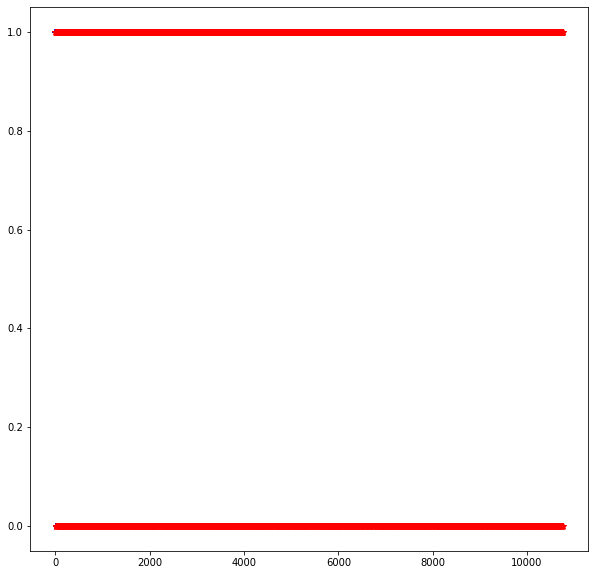

In [0]:
x = np.arange(len(y_true))
fig = plt.figure(figsize= (10, 10))
plt.scatter(x, y_true, color = 'blue', marker = '+')
plt.scatter(x, y_pred, color = 'red', marker = '*')
plt.show()

## Check the LSTM model

In [0]:
train_pred_temp = model.predict(x_train)  # on training data
train_pred_temp

array([[3.5438195e-08, 1.0000000e+00],
       [1.7725802e-06, 9.9999821e-01],
       [9.9999905e-01, 9.2801326e-07],
       ...,
       [5.1027257e-07, 9.9999952e-01],
       [1.5314973e-04, 9.9984682e-01],
       [8.9790374e-01, 1.0209632e-01]], dtype=float32)

In [0]:
train_pred = np.array([np.argmax(pred) for pred in train_pred_temp])
train_act = np.array(train_temp['sentiment'])
print(classification_report(train_act, train_pred))

              precision    recall  f1-score   support

           0       0.94      0.93      0.94      9577
           1       0.97      0.98      0.97     22588

    accuracy                           0.96     32165
   macro avg       0.96      0.95      0.96     32165
weighted avg       0.96      0.96      0.96     32165



In [0]:
[train_pred_temp[i][train_pred[i]-1] for i in range(5)]

[1.0, 0.9999982, 0.99999905, 1.0, 0.9999999]

In [0]:
train_pred[:5]

array([2, 2, 1, 2, 1])

In [0]:
train_pred

array([2, 2, 1, ..., 2, 2, 1])

In [0]:
y_pred = model.predict(x_test)
train_sentiments = []
for i in range(len(train_temp['sentiment'])):
    if train_temp['sentiment'][i] == 0:
        train_sentiments.append(min(train_pred_temp[i]))
    else:
        train_sentiments.append(max(train_pred_temp[i]))
test_sentiments = []
for i in range(len(test_temp['sentiment'])):
    if test_temp['sentiment'][i] == 0:
        test_sentiments.append(min(y_pred[i]))
    else:
        test_sentiments.append(max(y_pred[i]))

In [0]:
train_temp['sentiment_score'] = train_sentiments
test_temp['sentiment_score'] = test_sentiments

In [0]:
train_temp.head()

,name_of_drug,use_case_for_drug,review_by_patient,effectiveness_rating,number_of_times_prescribed,base_score,day,year,month_class,sentiment,sentiment_score
0,Valsartan,Left Ventricular Dysfunction,"""It has no side effect, I take it in combinati...",9,27,8.022969,20,12,1,1,1.000000e+00
1,Guanfacine,ADHD,"""My son is halfway through his fourth week of ...",8,192,7.858458,27,10,3,1,9.999982e-01
2,Lybrel,Birth Control,"""I used to take another oral contraceptive, wh...",5,17,6.341969,14,9,0,0,9.280133e-07
3,Buprenorphine / naloxone,Opiate Dependence,"""Suboxone has completely turned my life around...",9,37,6.590176,27,16,3,1,1.000000e+00
4,Cialis,Benign Prostatic Hyperplasia,"""2nd day on 5mg started to work with rock hard...",2,43,6.144782,28,15,3,0,1.054681e-07


In [0]:
test_temp.head()

,name_of_drug,review_by_patient,number_of_times_prescribed,use_case_for_drug,effectiveness_rating,day,year,month_class,sentiment,sentiment_score
0,Mirtazapine,"""I&#039;ve tried a few antidepressants over th...",22,Depression,10,28,12,0,1,1.000000
1,Contrave,"""Contrave combines drugs that were used for al...",35,Weight Loss,9,5,17,1,1,1.000000
2,Zyclara,"""4 days in on first 2 weeks. Using on arms an...",13,Keratosis,4,3,14,2,0,0.020863
3,Methadone,"""Ive been on Methadone for over ten years and ...",21,Opiate Withdrawal,7,18,16,3,1,1.000000
4,Ambien,"""Ditto on rebound sleepless when discontinued....",44,Insomnia,2,13,15,0,0,0.000730


In [0]:
# test_data_final = pd.DataFrame(y_pred, columns = ['effectiveness_score'])
# test_data_final.head()

In [0]:
# test_data_final['number_of_times_prescribed'] = test_data_master['number_of_times_prescribed']
# test_data_final.head()

## Finding Base Score from Effective Score and finalizing the Output

In [0]:
x_train = train_data_copy[['effectiveness_rating', 'number_of_times_prescribed']]
y_train = train_data_copy['base_score']
x_train.shape, y_train.shape 

((32165, 2), (32165,))

In [0]:
x_test = test_data_final[['effectiveness_score', 'number_of_times_prescribed']]
x_test.shape

(10760, 2)

In [0]:
x_train.shape, y_train.shape, x_test.shape

((32165, 2), (32165,), (10760, 2))

In [0]:
gb = GradientBoostingRegressor(max_depth = 15)
gb.fit(x_train, y_train)

NameError: ignored

In [0]:
predict_train = gb.predict(x_train)
print('Score on training data:', gb.score(x_train, y_train))
fig = plt.figure(figsize = (12, 8))
plt.plot(x_train['effectiveness_rating'], y_train, color = 'blue')
plt.plot(x_train['effectiveness_rating'], predict_train, color = 'red')
plt.show()

In [0]:
y_pred = gb.predict(x_test)

In [0]:
test_data_output = test_data_master.copy()
test_data_output = test_data_output[['patient_id']]
test_data_output['base_score'] = y_pred
test_data_output.head()

,patient_id,base_score
0,163740,10
1,39293,10
2,208087,10
3,23295,9
4,97013,1


In [0]:
test_data_output.to_csv('drug_base_score_prediction.csv', index = False)

## Including Sentiment Score

In [0]:
train_temp['day'] = train_temp['day'].astype('int')
train_temp['year'] = train_temp['year'].astype('int')
test_temp['day'] = test_temp['day'].astype('int')
test_temp['year'] = test_temp['year'].astype('int')

In [0]:
train_temp.columns

Index(['name_of_drug', 'use_case_for_drug', 'review_by_patient',
       'effectiveness_rating', 'number_of_times_prescribed', 'base_score',
       'day', 'year', 'month_class', 'sentiment', 'sentiment_score'],
      dtype='object')

In [0]:
x_final_train = train_temp[['day', 'year', 'month_class', 'number_of_times_prescribed', 'sentiment_score', 'effectiveness_rating']]
x_final_test = test_temp[['day', 'year', 'month_class', 'number_of_times_prescribed','sentiment_score', 'effectiveness_rating']]
y_final_train = train_temp[['base_score']]
x_final_train.shape, y_final_train.shape, x_final_test.shape

((32165, 6), (32165, 1), (10760, 6))

In [0]:
x_final_train.columns, x_final_test.columns

(Index(['day', 'year', 'month_class', 'number_of_times_prescribed',
        'sentiment_score', 'effectiveness_rating'],
       dtype='object'),
 Index(['day', 'year', 'month_class', 'number_of_times_prescribed',
        'sentiment_score', 'effectiveness_rating'],
       dtype='object'))

In [0]:
get_data_info(x_final_train)

Data has 32165 rows and 6 columns



,Column,Unique Entries,Null Entries,Data Type,Min,Max,Mean,Std Dev
0,day,31,0,int64,1.000000e+00,31.0,15.604570,8.770190
1,year,10,0,int64,8.000000e+00,17.0,13.981595,2.699433
2,month_class,4,0,int64,0.000000e+00,3.0,1.703218,1.165682
3,number_of_times_prescribed,303,0,int64,0.000000e+00,771.0,27.893207,35.819035
4,sentiment_score,13883,0,float64,7.250211e-13,1.0,0.701505,0.451413
5,effectiveness_rating,10,0,int64,1.000000e+00,10.0,6.998912,3.274781


In [0]:
get_data_info(x_final_test)

Data has 10760 rows and 6 columns



,Column,Unique Entries,Null Entries,Data Type,Min,Max,Mean,Std Dev
0,day,31,0,int64,1.000000e+00,31.0,15.711710,8.776271
1,year,10,0,int64,8.000000e+00,17.0,13.927323,2.721807
2,month_class,4,0,int64,0.000000e+00,3.0,1.692007,1.171323
3,number_of_times_prescribed,233,0,int64,0.000000e+00,484.0,27.596004,34.050059
4,sentiment_score,6334,0,float64,1.301472e-12,1.0,0.691679,0.438969
5,effectiveness_rating,10,0,int64,1.000000e+00,10.0,6.963755,3.275637


In [0]:
from sklearn.ensemble import GradientBoostingRegressor
gb = GradientBoostingRegressor()

In [0]:
gb.fit(x_final_train, y_final_train)

GradientBoostingRegressor(alpha=0.9, ccp_alpha=0.0, criterion='friedman_mse',
                          init=None, learning_rate=0.1, loss='ls', max_depth=3,
                          max_features=None, max_leaf_nodes=None,
                          min_impurity_decrease=0.0, min_impurity_split=None,
                          min_samples_leaf=1, min_samples_split=2,
                          min_weight_fraction_leaf=0.0, n_estimators=100,
                          n_iter_no_change=None, presort='deprecated',
                          random_state=None, subsample=1.0, tol=0.0001,
                          validation_fraction=0.1, verbose=0, warm_start=False)

Score on training data: 0.8800588350889293


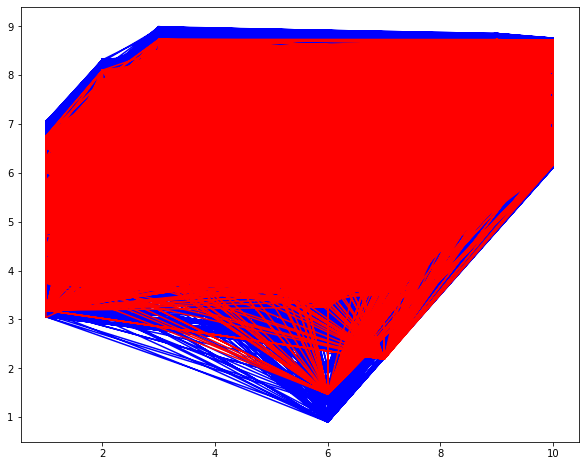

In [0]:
predict_train = gb.predict(x_final_train)
print('Score on training data:', gb.score(x_final_train, y_final_train))
fig = plt.figure(figsize = (10, 8))
plt.plot(x_final_train['effectiveness_rating'], y_final_train, color = 'blue')
plt.plot(x_final_train['effectiveness_rating'], predict_train, color = 'red')
plt.show()

In [0]:
y_pred_final = gb.predict(x_final_test)

In [0]:
test_data_output = test_data_master.copy()
# test_data_output = test_data_output[['patient_id']]
test_data_output['base_score'] = y_pred_final
test_data_output.head()

,patient_id,name_of_drug,review_by_patient,drug_approved_by_UIC,number_of_times_prescribed,use_case_for_drug,effectiveness_rating,base_score
0,163740,Mirtazapine,"""I&#039;ve tried a few antidepressants over th...",28-Feb-12,22,Depression,10,8.382990
1,39293,Contrave,"""Contrave combines drugs that were used for al...",5-Mar-17,35,Weight Loss,9,8.352625
2,208087,Zyclara,"""4 days in on first 2 weeks. Using on arms an...",3-Jul-14,13,Keratosis,4,5.981615
3,23295,Methadone,"""Ive been on Methadone for over ten years and ...",18-Oct-16,21,Opiate Withdrawal,7,5.641171
4,97013,Ambien,"""Ditto on rebound sleepless when discontinued....",13-Jan-15,44,Insomnia,2,6.516422


In [0]:
output = test_data_output[['patient_id', 'base_score']]
output.head()

,patient_id,base_score
0,163740,8.382990
1,39293,8.352625
2,208087,5.981615
3,23295,5.641171
4,97013,6.516422


In [0]:
output.to_csv('drug_base_score_prediction_SentimentScore.csv', index = False)